# Afriat

In [1]:
scan=0.1375

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2554,3263,9426
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2554,2553,1663,3441,1628,3404
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4507,10736
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 651,846,2313
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 651,649,445,849,421,795
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1077,2733
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:10:57, 13.12s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:10:57, 13.12s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=56.4]

Epoch 2/600:   0%|          | 1/600 [00:13<2:10:57, 13.12s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=56.4]

Epoch 2/600:   0%|          | 2/600 [00:24<2:03:28, 12.39s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=56.4]

Epoch 2/600:   0%|          | 2/600 [00:24<2:03:28, 12.39s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=83.8]

Epoch 3/600:   0%|          | 2/600 [00:25<2:03:28, 12.39s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=83.8]

Epoch 3/600:   0%|          | 3/600 [00:36<2:01:06, 12.17s/it, v_num=1, total_loss_train=3.24e+3, kl_local_train=83.8]

Epoch 3/600:   0%|          | 3/600 [00:36<2:01:06, 12.17s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.5]

Epoch 4/600:   0%|          | 3/600 [00:36<2:01:06, 12.17s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.5]

Epoch 4/600:   1%|          | 4/600 [00:48<1:59:27, 12.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.5]

Epoch 4/600:   1%|          | 4/600 [00:48<1:59:27, 12.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=82.8]

Epoch 5/600:   1%|          | 4/600 [00:48<1:59:27, 12.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=82.8]

Epoch 5/600:   1%|          | 5/600 [01:00<1:59:02, 12.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=82.8]

Epoch 5/600:   1%|          | 5/600 [01:00<1:59:02, 12.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=76.3]

Epoch 6/600:   1%|          | 5/600 [01:01<1:59:02, 12.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=76.3]

Epoch 6/600:   1%|          | 6/600 [01:13<2:00:58, 12.22s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=76.3]

Epoch 6/600:   1%|          | 6/600 [01:13<2:00:58, 12.22s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:13<2:00:58, 12.22s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:25<2:00:36, 12.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:25<2:00:36, 12.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:25<2:00:36, 12.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:37<2:01:18, 12.29s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:37<2:01:18, 12.29s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:37<2:01:18, 12.29s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:50<2:01:27, 12.33s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=32.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:50<2:01:27, 12.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]  

Epoch 10/600:   2%|▏         | 9/600 [01:50<2:01:27, 12.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:02<2:01:54, 12.40s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:02<2:01:54, 12.40s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 10/600 [02:04<2:01:54, 12.40s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:16<2:05:47, 12.81s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=28.1, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00745, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:16<2:05:47, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]   

Epoch 12/600:   2%|▏         | 11/600 [02:16<2:05:47, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 12/600:   2%|▏         | 12/600 [02:29<2:04:29, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=37, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 12/600:   2%|▏         | 12/600 [02:29<2:04:29, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 12/600 [02:29<2:04:29, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 13/600 [02:41<2:03:09, 12.59s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 13/600:   2%|▏         | 13/600 [02:41<2:03:09, 12.59s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 13/600 [02:41<2:03:09, 12.59s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 14/600 [02:53<2:02:18, 12.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 14/600:   2%|▏         | 14/600 [02:53<2:02:18, 12.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 15/600:   2%|▏         | 14/600 [02:53<2:02:18, 12.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 15/600:   2%|▎         | 15/600 [03:06<2:01:50, 12.50s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 15/600:   2%|▎         | 15/600 [03:06<2:01:50, 12.50s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   2%|▎         | 15/600 [03:07<2:01:50, 12.50s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   3%|▎         | 16/600 [03:19<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0188, metric_mi|mouse_train=0.0442]

Epoch 16/600:   3%|▎         | 16/600 [03:19<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 17/600:   3%|▎         | 16/600 [03:20<2:05:12, 12.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 17/600:   3%|▎         | 17/600 [03:32<2:03:30, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 17/600:   3%|▎         | 17/600 [03:32<2:03:30, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 18/600:   3%|▎         | 17/600 [03:32<2:03:30, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 18/600:   3%|▎         | 18/600 [03:44<2:02:14, 12.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 18/600:   3%|▎         | 18/600 [03:44<2:02:14, 12.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 19/600:   3%|▎         | 18/600 [03:44<2:02:14, 12.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 19/600:   3%|▎         | 19/600 [03:57<2:01:16, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=68.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 19/600:   3%|▎         | 19/600 [03:57<2:01:16, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 20/600:   3%|▎         | 19/600 [03:57<2:01:16, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 20/600:   3%|▎         | 20/600 [04:09<2:00:39, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 20/600:   3%|▎         | 20/600 [04:09<2:00:39, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]  

Epoch 21/600:   3%|▎         | 20/600 [04:10<2:00:39, 12.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 21/600:   4%|▎         | 21/600 [04:23<2:04:10, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0675]

Epoch 21/600:   4%|▎         | 21/600 [04:23<2:04:10, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 22/600:   4%|▎         | 21/600 [04:23<2:04:10, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 22/600:   4%|▎         | 22/600 [04:35<2:02:37, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 22/600:   4%|▎         | 22/600 [04:35<2:02:37, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 23/600:   4%|▎         | 22/600 [04:35<2:02:37, 12.73s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 23/600:   4%|▍         | 23/600 [04:47<2:01:16, 12.61s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 23/600:   4%|▍         | 23/600 [04:47<2:01:16, 12.61s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834] 

Epoch 24/600:   4%|▍         | 23/600 [04:47<2:01:16, 12.61s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 24/600:   4%|▍         | 24/600 [05:00<2:00:32, 12.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 24/600:   4%|▍         | 24/600 [05:00<2:00:32, 12.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 25/600:   4%|▍         | 24/600 [05:00<2:00:32, 12.56s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 25/600:   4%|▍         | 25/600 [05:12<2:00:03, 12.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 25/600:   4%|▍         | 25/600 [05:12<2:00:03, 12.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 26/600:   4%|▍         | 25/600 [05:14<2:00:03, 12.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 26/600:   4%|▍         | 26/600 [05:26<2:03:44, 12.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0561, metric_mi|time_cat_train=0.0667, metric_mi|mouse_train=0.0834]

Epoch 26/600:   4%|▍         | 26/600 [05:26<2:03:44, 12.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=117, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]  

Epoch 27/600:   4%|▍         | 26/600 [05:26<2:03:44, 12.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=117, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 27/600:   4%|▍         | 27/600 [05:39<2:02:06, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=117, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 27/600:   4%|▍         | 27/600 [05:39<2:02:06, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 28/600:   4%|▍         | 27/600 [05:39<2:02:06, 12.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 28/600:   5%|▍         | 28/600 [05:51<2:00:56, 12.69s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 28/600:   5%|▍         | 28/600 [05:51<2:00:56, 12.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992] 

Epoch 29/600:   5%|▍         | 28/600 [05:51<2:00:56, 12.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 29/600:   5%|▍         | 29/600 [06:04<2:00:00, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 29/600:   5%|▍         | 29/600 [06:04<2:00:00, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 30/600:   5%|▍         | 29/600 [06:04<2:00:00, 12.61s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 30/600:   5%|▌         | 30/600 [06:16<1:59:25, 12.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 30/600:   5%|▌         | 30/600 [06:16<1:59:25, 12.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 31/600:   5%|▌         | 30/600 [06:17<1:59:25, 12.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 31/600:   5%|▌         | 31/600 [06:30<2:02:49, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0992]

Epoch 31/600:   5%|▌         | 31/600 [06:30<2:02:49, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]  

Epoch 32/600:   5%|▌         | 31/600 [06:30<2:02:49, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 32/600:   5%|▌         | 32/600 [06:42<2:00:17, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 32/600:   5%|▌         | 32/600 [06:42<2:00:17, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 33/600:   5%|▌         | 32/600 [06:42<2:00:17, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 33/600:   6%|▌         | 33/600 [06:55<1:59:34, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 33/600:   6%|▌         | 33/600 [06:55<1:59:34, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 33/600 [06:55<1:59:34, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 34/600 [07:07<1:58:53, 12.60s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 34/600 [07:07<1:58:53, 12.60s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 34/600 [07:07<1:58:53, 12.60s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 35/600 [07:20<1:58:25, 12.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 35/600 [07:20<1:58:25, 12.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 35/600 [07:21<1:58:25, 12.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 36/600 [07:33<2:01:46, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 36/600 [07:33<2:01:46, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 36/600 [07:33<2:01:46, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [07:46<2:00:22, 12.83s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [07:46<2:00:22, 12.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▌         | 37/600 [07:46<2:00:22, 12.83s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [07:58<1:59:12, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [07:58<1:59:12, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 38/600 [07:58<1:59:12, 12.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:11<1:58:29, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:11<1:58:29, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   6%|▋         | 39/600 [08:11<1:58:29, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:23<1:57:48, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:23<1:57:48, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 40/600 [08:25<1:57:48, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:37<2:01:03, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:37<2:01:03, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 42/600:   7%|▋         | 41/600 [08:37<2:01:03, 12.99s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 42/600:   7%|▋         | 42/600 [08:50<1:59:44, 12.88s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 42/600:   7%|▋         | 42/600 [08:50<1:59:44, 12.88s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]  

Epoch 43/600:   7%|▋         | 42/600 [08:50<1:59:44, 12.88s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 43/600:   7%|▋         | 43/600 [09:02<1:58:38, 12.78s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 43/600:   7%|▋         | 43/600 [09:02<1:58:38, 12.78s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 44/600:   7%|▋         | 43/600 [09:02<1:58:38, 12.78s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 44/600:   7%|▋         | 44/600 [09:15<1:57:44, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 44/600:   7%|▋         | 44/600 [09:15<1:57:44, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=95.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 45/600:   7%|▋         | 44/600 [09:15<1:57:44, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=95.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 45/600:   8%|▊         | 45/600 [09:28<1:57:17, 12.68s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=95.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 45/600:   8%|▊         | 45/600 [09:28<1:57:17, 12.68s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 46/600:   8%|▊         | 45/600 [09:29<1:57:17, 12.68s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 46/600:   8%|▊         | 46/600 [09:41<2:00:19, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 46/600:   8%|▊         | 46/600 [09:41<2:00:19, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]  

Epoch 47/600:   8%|▊         | 46/600 [09:41<2:00:19, 13.03s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|▊         | 47/600 [09:54<1:58:34, 12.86s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|▊         | 47/600 [09:54<1:58:34, 12.86s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|▊         | 47/600 [09:54<1:58:34, 12.86s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|▊         | 48/600 [10:07<1:58:36, 12.89s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=96.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|▊         | 48/600 [10:07<1:58:36, 12.89s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|▊         | 48/600 [10:07<1:58:36, 12.89s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|▊         | 49/600 [10:22<2:03:31, 13.45s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|▊         | 49/600 [10:22<2:03:31, 13.45s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|▊         | 49/600 [10:22<2:03:31, 13.45s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|▊         | 50/600 [10:36<2:06:30, 13.80s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|▊         | 50/600 [10:36<2:06:30, 13.80s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|▊         | 50/600 [10:38<2:06:30, 13.80s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|▊         | 51/600 [10:52<2:12:23, 14.47s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|▊         | 51/600 [10:52<2:12:23, 14.47s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129] 

Epoch 52/600:   8%|▊         | 51/600 [10:52<2:12:23, 14.47s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [11:07<2:12:49, 14.54s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=95.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [11:07<2:12:49, 14.54s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=94.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▊         | 52/600 [11:07<2:12:49, 14.54s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=94.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:22<2:13:01, 14.59s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=94.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:22<2:13:01, 14.59s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 53/600 [11:22<2:13:01, 14.59s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:36<2:13:03, 14.62s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=93.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:36<2:13:03, 14.62s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 54/600 [11:36<2:13:03, 14.62s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [11:51<2:12:52, 14.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [11:51<2:12:52, 14.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 55/600 [11:52<2:12:52, 14.63s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [12:07<2:16:37, 15.07s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=91.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [12:07<2:16:37, 15.07s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:   9%|▉         | 56/600 [12:07<2:16:37, 15.07s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|▉         | 57/600 [12:22<2:15:26, 14.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|▉         | 57/600 [12:22<2:15:26, 14.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]  

Epoch 58/600:  10%|▉         | 57/600 [12:22<2:15:26, 14.97s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|▉         | 58/600 [12:37<2:14:36, 14.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=90, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|▉         | 58/600 [12:37<2:14:36, 14.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|▉         | 58/600 [12:37<2:14:36, 14.90s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|▉         | 59/600 [12:51<2:14:00, 14.86s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=89.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|▉         | 59/600 [12:51<2:14:00, 14.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=88.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|▉         | 59/600 [12:51<2:14:00, 14.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=88.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|█         | 60/600 [13:06<2:13:16, 14.81s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=88.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|█         | 60/600 [13:06<2:13:16, 14.81s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|█         | 60/600 [13:07<2:13:16, 14.81s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|█         | 61/600 [13:22<2:17:21, 15.29s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|█         | 61/600 [13:22<2:17:21, 15.29s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 61/600 [13:22<2:17:21, 15.29s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 62/600 [13:37<2:15:38, 15.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=86.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 62/600 [13:37<2:15:38, 15.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 62/600 [13:37<2:15:38, 15.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 63/600 [13:52<2:14:19, 15.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 63/600 [13:52<2:14:19, 15.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 64/600:  10%|█         | 63/600 [13:52<2:14:19, 15.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 64/600:  11%|█         | 64/600 [14:07<2:13:22, 14.93s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=85.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 64/600:  11%|█         | 64/600 [14:07<2:13:22, 14.93s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 64/600 [14:07<2:13:22, 14.93s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 65/600 [14:21<2:12:30, 14.86s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=84.7, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 65/600 [14:21<2:12:30, 14.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=85.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126] 

Epoch 66/600:  11%|█         | 65/600 [14:23<2:12:30, 14.86s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=85.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 66/600:  11%|█         | 66/600 [14:38<2:15:35, 15.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=85.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 66/600:  11%|█         | 66/600 [14:38<2:15:35, 15.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 66/600 [14:38<2:15:35, 15.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:52<2:13:53, 15.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:52<2:13:53, 15.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█         | 67/600 [14:52<2:13:53, 15.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [15:07<2:12:58, 15.00s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=83.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [15:07<2:12:58, 15.00s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 69/600:  11%|█▏        | 68/600 [15:07<2:12:58, 15.00s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [15:22<2:12:19, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [15:22<2:12:19, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 69/600 [15:22<2:12:19, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [15:37<2:12:05, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=82.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [15:37<2:12:05, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 70/600 [15:38<2:12:05, 14.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:14:45, 15.28s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=81.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:14:45, 15.28s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|█▏        | 71/600 [15:53<2:14:45, 15.28s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|█▏        | 72/600 [16:08<2:12:48, 15.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|█▏        | 72/600 [16:08<2:12:48, 15.09s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 72/600 [16:08<2:12:48, 15.09s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 73/600 [16:22<2:11:24, 14.96s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 73/600 [16:22<2:11:24, 14.96s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 73/600 [16:22<2:11:24, 14.96s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 74/600 [16:37<2:10:21, 14.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 74/600 [16:37<2:10:21, 14.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▏        | 74/600 [16:37<2:10:21, 14.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▎        | 75/600 [16:51<2:09:30, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▎        | 75/600 [16:51<2:09:30, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 76/600:  12%|█▎        | 75/600 [16:53<2:09:30, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|█▎        | 76/600 [17:08<2:12:52, 15.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|█▎        | 76/600 [17:08<2:12:52, 15.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 76/600 [17:08<2:12:52, 15.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:22<2:11:29, 15.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [17:22<2:11:29, 15.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]  

Epoch 78/600:  13%|█▎        | 77/600 [17:22<2:11:29, 15.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:37<2:10:13, 14.97s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=77, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [17:37<2:10:13, 14.97s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 78/600 [17:37<2:10:13, 14.97s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:52<2:10:21, 15.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=76.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [17:52<2:10:21, 15.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 79/600 [17:52<2:10:21, 15.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [18:07<2:09:15, 14.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [18:07<2:09:15, 14.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]  

Epoch 81/600:  13%|█▎        | 80/600 [18:08<2:09:15, 14.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:23<2:12:09, 15.28s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [18:23<2:12:09, 15.28s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 81/600 [18:23<2:12:09, 15.28s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 82/600 [18:38<2:10:31, 15.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=76, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 82/600 [18:38<2:10:31, 15.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=75.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 83/600:  14%|█▎        | 82/600 [18:38<2:10:31, 15.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=75.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 83/600:  14%|█▍        | 83/600 [18:53<2:09:18, 15.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=75.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 83/600:  14%|█▍        | 83/600 [18:53<2:09:18, 15.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 83/600 [18:53<2:09:18, 15.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 84/600 [19:07<2:08:09, 14.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 84/600 [19:07<2:08:09, 14.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 84/600 [19:07<2:08:09, 14.90s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 85/600 [19:22<2:07:21, 14.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 85/600 [19:22<2:07:21, 14.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]  

Epoch 86/600:  14%|█▍        | 85/600 [19:23<2:07:21, 14.84s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 86/600:  14%|█▍        | 86/600 [19:38<2:09:59, 15.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 86/600:  14%|█▍        | 86/600 [19:38<2:09:59, 15.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 87/600:  14%|█▍        | 86/600 [19:38<2:09:59, 15.17s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 87/600:  14%|█▍        | 87/600 [19:52<2:08:07, 14.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=74.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 87/600:  14%|█▍        | 87/600 [19:52<2:08:07, 14.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 88/600:  14%|█▍        | 87/600 [19:52<2:08:07, 14.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 88/600:  15%|█▍        | 88/600 [20:07<2:07:16, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 88/600:  15%|█▍        | 88/600 [20:07<2:07:16, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 89/600:  15%|█▍        | 88/600 [20:07<2:07:16, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 89/600:  15%|█▍        | 89/600 [20:22<2:07:04, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=73.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 89/600:  15%|█▍        | 89/600 [20:22<2:07:04, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 90/600:  15%|█▍        | 89/600 [20:22<2:07:04, 14.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 90/600:  15%|█▌        | 90/600 [20:37<2:05:57, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 90/600:  15%|█▌        | 90/600 [20:37<2:05:57, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 91/600:  15%|█▌        | 90/600 [20:38<2:05:57, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 91/600:  15%|█▌        | 91/600 [20:53<2:08:47, 15.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 91/600:  15%|█▌        | 91/600 [20:53<2:08:47, 15.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 91/600 [20:53<2:08:47, 15.18s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 92/600 [21:07<2:07:06, 15.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=72.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 92/600 [21:07<2:07:06, 15.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 93/600:  15%|█▌        | 92/600 [21:07<2:07:06, 15.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 93/600:  16%|█▌        | 93/600 [21:22<2:05:56, 14.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 93/600:  16%|█▌        | 93/600 [21:22<2:05:56, 14.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 93/600 [21:22<2:05:56, 14.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 94/600 [21:37<2:05:00, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 94/600 [21:37<2:05:00, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 94/600 [21:37<2:05:00, 14.82s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 95/600 [21:51<2:04:52, 14.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=71.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 95/600 [21:51<2:04:52, 14.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]  

Epoch 96/600:  16%|█▌        | 95/600 [21:53<2:04:52, 14.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 96/600:  16%|█▌        | 96/600 [22:07<2:07:26, 15.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 96/600:  16%|█▌        | 96/600 [22:07<2:07:26, 15.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 96/600 [22:07<2:07:26, 15.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [22:22<2:05:44, 15.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|█▌        | 97/600 [22:22<2:05:44, 15.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▌        | 97/600 [22:22<2:05:44, 15.00s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [22:37<2:04:33, 14.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|█▋        | 98/600 [22:37<2:04:33, 14.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 98/600 [22:37<2:04:33, 14.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [22:51<2:03:36, 14.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|█▋        | 99/600 [22:51<2:03:36, 14.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  16%|█▋        | 99/600 [22:51<2:03:36, 14.80s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [23:06<2:03:00, 14.76s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|█▋        | 100/600 [23:06<2:03:00, 14.76s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 100/600 [23:07<2:03:00, 14.76s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [23:22<2:05:46, 15.12s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|█▋        | 101/600 [23:22<2:05:46, 15.12s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|█▋        | 101/600 [23:22<2:05:46, 15.12s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|█▋        | 102/600 [23:36<2:04:12, 14.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=69.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|█▋        | 102/600 [23:36<2:04:12, 14.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|█▋        | 102/600 [23:36<2:04:12, 14.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|█▋        | 103/600 [23:51<2:03:01, 14.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|█▋        | 103/600 [23:51<2:03:01, 14.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|█▋        | 103/600 [23:51<2:03:01, 14.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|█▋        | 104/600 [24:06<2:02:15, 14.79s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=68.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|█▋        | 104/600 [24:06<2:02:15, 14.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 105/600:  17%|█▋        | 104/600 [24:06<2:02:15, 14.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|█▊        | 105/600 [24:20<2:01:51, 14.77s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|█▊        | 105/600 [24:20<2:01:51, 14.77s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|█▊        | 105/600 [24:22<2:01:51, 14.77s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|█▊        | 106/600 [24:37<2:04:55, 15.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|█▊        | 106/600 [24:37<2:04:55, 15.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 106/600 [24:37<2:04:55, 15.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:51<2:03:19, 15.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [24:51<2:03:19, 15.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 107/600 [24:51<2:03:19, 15.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [25:04<1:58:45, 14.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [25:04<1:58:45, 14.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 108/600 [25:04<1:58:45, 14.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [25:17<1:53:38, 13.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=67.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [25:17<1:53:38, 13.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 109/600 [25:17<1:53:38, 13.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [25:29<1:50:06, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [25:29<1:50:06, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 110/600 [25:31<1:50:06, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [25:43<1:50:48, 13.60s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [25:43<1:50:48, 13.60s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  18%|█▊        | 111/600 [25:43<1:50:48, 13.60s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [25:56<1:47:49, 13.26s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [25:56<1:47:49, 13.26s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▊        | 112/600 [25:56<1:47:49, 13.26s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [26:08<1:45:38, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [26:08<1:45:38, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 113/600 [26:08<1:45:38, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [26:21<1:43:57, 12.84s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=65.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [26:21<1:43:57, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 114/600 [26:21<1:43:57, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [26:33<1:42:10, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [26:33<1:42:10, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 115/600 [26:34<1:42:10, 12.64s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [26:47<1:45:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [26:47<1:45:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]  

Epoch 117/600:  19%|█▉        | 116/600 [26:47<1:45:11, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:59<1:42:55, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [26:59<1:42:55, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 117/600 [26:59<1:42:55, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [27:11<1:41:54, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [27:11<1:41:54, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 118/600 [27:11<1:41:54, 12.69s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [27:24<1:41:05, 12.61s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [27:24<1:41:05, 12.61s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|█▉        | 119/600 [27:24<1:41:05, 12.61s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [27:36<1:40:27, 12.56s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [27:36<1:40:27, 12.56s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 120/600 [27:38<1:40:27, 12.56s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [27:50<1:43:15, 12.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [27:50<1:43:15, 12.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 121/600 [27:50<1:43:15, 12.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [28:03<1:41:59, 12.80s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|██        | 122/600 [28:03<1:41:59, 12.80s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 122/600 [28:03<1:41:59, 12.80s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [28:15<1:40:22, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|██        | 123/600 [28:15<1:40:22, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 124/600:  20%|██        | 123/600 [28:15<1:40:22, 12.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [28:26<1:37:28, 12.29s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|██        | 124/600 [28:26<1:37:28, 12.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 124/600 [28:26<1:37:28, 12.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [28:38<1:35:16, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|██        | 125/600 [28:38<1:35:16, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 125/600 [28:39<1:35:16, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [28:50<1:36:35, 12.23s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|██        | 126/600 [28:50<1:36:35, 12.23s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 127/600:  21%|██        | 126/600 [28:50<1:36:35, 12.23s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 127/600:  21%|██        | 127/600 [29:02<1:34:39, 12.01s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 127/600:  21%|██        | 127/600 [29:02<1:34:39, 12.01s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 128/600:  21%|██        | 127/600 [29:02<1:34:39, 12.01s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 128/600:  21%|██▏       | 128/600 [29:13<1:33:06, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 128/600:  21%|██▏       | 128/600 [29:13<1:33:06, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 129/600:  21%|██▏       | 128/600 [29:13<1:33:06, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 129/600:  22%|██▏       | 129/600 [29:25<1:31:56, 11.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 129/600:  22%|██▏       | 129/600 [29:25<1:31:56, 11.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 130/600:  22%|██▏       | 129/600 [29:25<1:31:56, 11.71s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 130/600:  22%|██▏       | 130/600 [29:36<1:30:58, 11.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=62.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 130/600:  22%|██▏       | 130/600 [29:36<1:30:58, 11.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 131/600:  22%|██▏       | 130/600 [29:37<1:30:58, 11.61s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 131/600:  22%|██▏       | 131/600 [29:49<1:33:17, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0957, metric_mi|mouse_train=0.0997]

Epoch 131/600:  22%|██▏       | 131/600 [29:49<1:33:17, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|██▏       | 131/600 [29:49<1:33:17, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|██▏       | 132/600 [30:01<1:32:21, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|██▏       | 132/600 [30:01<1:32:21, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|██▏       | 132/600 [30:01<1:32:21, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|██▏       | 133/600 [30:13<1:33:40, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|██▏       | 133/600 [30:13<1:33:40, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|██▏       | 133/600 [30:13<1:33:40, 12.03s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|██▏       | 134/600 [30:25<1:34:32, 12.17s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|██▏       | 134/600 [30:26<1:34:32, 12.17s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|██▏       | 134/600 [30:26<1:34:32, 12.17s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|██▎       | 135/600 [30:38<1:34:26, 12.19s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=61.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|██▎       | 135/600 [30:38<1:34:26, 12.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 136/600:  22%|██▎       | 135/600 [30:39<1:34:26, 12.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 136/600:  23%|██▎       | 136/600 [30:52<1:37:59, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0984]

Epoch 136/600:  23%|██▎       | 136/600 [30:52<1:37:59, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 137/600:  23%|██▎       | 136/600 [30:52<1:37:59, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 137/600:  23%|██▎       | 137/600 [31:04<1:37:15, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 137/600:  23%|██▎       | 137/600 [31:04<1:37:15, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 138/600:  23%|██▎       | 137/600 [31:04<1:37:15, 12.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 138/600:  23%|██▎       | 138/600 [31:16<1:36:44, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 138/600:  23%|██▎       | 138/600 [31:16<1:36:44, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 139/600:  23%|██▎       | 138/600 [31:16<1:36:44, 12.56s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 139/600:  23%|██▎       | 139/600 [31:29<1:36:20, 12.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 139/600:  23%|██▎       | 139/600 [31:29<1:36:20, 12.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 140/600:  23%|██▎       | 139/600 [31:29<1:36:20, 12.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 140/600:  23%|██▎       | 140/600 [31:41<1:35:58, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 140/600:  23%|██▎       | 140/600 [31:41<1:35:58, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 141/600:  23%|██▎       | 140/600 [31:43<1:35:58, 12.52s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 141/600:  24%|██▎       | 141/600 [31:55<1:38:42, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0921, metric_mi|mouse_train=0.0971]

Epoch 141/600:  24%|██▎       | 141/600 [31:55<1:38:42, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 142/600:  24%|██▎       | 141/600 [31:55<1:38:42, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 142/600:  24%|██▎       | 142/600 [32:08<1:37:31, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 142/600:  24%|██▎       | 142/600 [32:08<1:37:31, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 143/600:  24%|██▎       | 142/600 [32:08<1:37:31, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 143/600:  24%|██▍       | 143/600 [32:20<1:36:30, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 143/600:  24%|██▍       | 143/600 [32:20<1:36:30, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 144/600:  24%|██▍       | 143/600 [32:20<1:36:30, 12.67s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 144/600:  24%|██▍       | 144/600 [32:33<1:35:59, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 144/600:  24%|██▍       | 144/600 [32:33<1:35:59, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 145/600:  24%|██▍       | 144/600 [32:33<1:35:59, 12.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 145/600:  24%|██▍       | 145/600 [32:45<1:35:25, 12.58s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 145/600:  24%|██▍       | 145/600 [32:45<1:35:25, 12.58s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 146/600:  24%|██▍       | 145/600 [32:46<1:35:25, 12.58s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 146/600:  24%|██▍       | 146/600 [32:59<1:38:06, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0916, metric_mi|mouse_train=0.0964]

Epoch 146/600:  24%|██▍       | 146/600 [32:59<1:38:06, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 147/600:  24%|██▍       | 146/600 [32:59<1:38:06, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 147/600:  24%|██▍       | 147/600 [33:11<1:36:45, 12.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 147/600:  24%|██▍       | 147/600 [33:11<1:36:45, 12.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 148/600:  24%|██▍       | 147/600 [33:11<1:36:45, 12.82s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 148/600:  25%|██▍       | 148/600 [33:24<1:35:52, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 148/600:  25%|██▍       | 148/600 [33:24<1:35:52, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 149/600:  25%|██▍       | 148/600 [33:24<1:35:52, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 149/600:  25%|██▍       | 149/600 [33:36<1:35:12, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 149/600:  25%|██▍       | 149/600 [33:36<1:35:12, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 150/600:  25%|██▍       | 149/600 [33:36<1:35:12, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 150/600:  25%|██▌       | 150/600 [33:49<1:34:26, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 150/600:  25%|██▌       | 150/600 [33:49<1:34:26, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 151/600:  25%|██▌       | 150/600 [33:50<1:34:26, 12.59s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 151/600:  25%|██▌       | 151/600 [34:03<1:36:57, 12.96s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0965]

Epoch 151/600:  25%|██▌       | 151/600 [34:03<1:36:57, 12.96s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 152/600:  25%|██▌       | 151/600 [34:03<1:36:57, 12.96s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 152/600:  25%|██▌       | 152/600 [34:15<1:35:08, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 152/600:  25%|██▌       | 152/600 [34:15<1:35:08, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 153/600:  25%|██▌       | 152/600 [34:15<1:35:08, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 153/600:  26%|██▌       | 153/600 [34:27<1:34:25, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 153/600:  26%|██▌       | 153/600 [34:27<1:34:25, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 154/600:  26%|██▌       | 153/600 [34:27<1:34:25, 12.67s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 154/600:  26%|██▌       | 154/600 [34:40<1:33:48, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 154/600:  26%|██▌       | 154/600 [34:40<1:33:48, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 155/600:  26%|██▌       | 154/600 [34:40<1:33:48, 12.62s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 155/600:  26%|██▌       | 155/600 [34:52<1:33:15, 12.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 155/600:  26%|██▌       | 155/600 [34:52<1:33:15, 12.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 156/600:  26%|██▌       | 155/600 [34:54<1:33:15, 12.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 156/600:  26%|██▌       | 156/600 [35:06<1:36:04, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0972]

Epoch 156/600:  26%|██▌       | 156/600 [35:06<1:36:04, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]  

Epoch 157/600:  26%|██▌       | 156/600 [35:06<1:36:04, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 157/600:  26%|██▌       | 157/600 [35:19<1:34:59, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 157/600:  26%|██▌       | 157/600 [35:19<1:34:59, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▌       | 157/600 [35:19<1:34:59, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▋       | 158/600 [35:32<1:34:18, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▋       | 158/600 [35:32<1:34:18, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 158/600 [35:32<1:34:18, 12.80s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 159/600 [35:44<1:33:33, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 159/600 [35:44<1:33:33, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 160/600:  26%|██▋       | 159/600 [35:44<1:33:33, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 160/600:  27%|██▋       | 160/600 [35:57<1:32:51, 12.66s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 160/600:  27%|██▋       | 160/600 [35:57<1:32:51, 12.66s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097] 

Epoch 161/600:  27%|██▋       | 160/600 [35:58<1:32:51, 12.66s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 161/600:  27%|██▋       | 161/600 [36:11<1:35:23, 13.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.097]

Epoch 161/600:  27%|██▋       | 161/600 [36:11<1:35:23, 13.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 162/600:  27%|██▋       | 161/600 [36:11<1:35:23, 13.04s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 162/600:  27%|██▋       | 162/600 [36:23<1:34:10, 12.90s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 162/600:  27%|██▋       | 162/600 [36:23<1:34:10, 12.90s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 163/600:  27%|██▋       | 162/600 [36:23<1:34:10, 12.90s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 163/600:  27%|██▋       | 163/600 [36:36<1:33:17, 12.81s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 163/600:  27%|██▋       | 163/600 [36:36<1:33:17, 12.81s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 164/600:  27%|██▋       | 163/600 [36:36<1:33:17, 12.81s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 164/600:  27%|██▋       | 164/600 [36:48<1:32:33, 12.74s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 164/600:  27%|██▋       | 164/600 [36:48<1:32:33, 12.74s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 165/600:  27%|██▋       | 164/600 [36:48<1:32:33, 12.74s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 165/600:  28%|██▊       | 165/600 [37:01<1:32:01, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 165/600:  28%|██▊       | 165/600 [37:01<1:32:01, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 166/600:  28%|██▊       | 165/600 [37:02<1:32:01, 12.69s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 166/600:  28%|██▊       | 166/600 [37:15<1:34:28, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0968]

Epoch 166/600:  28%|██▊       | 166/600 [37:15<1:34:28, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 167/600:  28%|██▊       | 166/600 [37:15<1:34:28, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 167/600:  28%|██▊       | 167/600 [37:27<1:33:19, 12.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 167/600:  28%|██▊       | 167/600 [37:27<1:33:19, 12.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 168/600:  28%|██▊       | 167/600 [37:27<1:33:19, 12.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 168/600:  28%|██▊       | 168/600 [37:40<1:32:18, 12.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 168/600:  28%|██▊       | 168/600 [37:40<1:32:18, 12.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 169/600:  28%|██▊       | 168/600 [37:40<1:32:18, 12.82s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 169/600:  28%|██▊       | 169/600 [37:53<1:31:42, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 169/600:  28%|██▊       | 169/600 [37:53<1:31:42, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 170/600:  28%|██▊       | 169/600 [37:53<1:31:42, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 170/600:  28%|██▊       | 170/600 [38:05<1:31:09, 12.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 170/600:  28%|██▊       | 170/600 [38:05<1:31:09, 12.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 171/600:  28%|██▊       | 170/600 [38:07<1:31:09, 12.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 171/600:  28%|██▊       | 171/600 [38:19<1:33:33, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0906, metric_mi|mouse_train=0.0954]

Epoch 171/600:  28%|██▊       | 171/600 [38:19<1:33:33, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 172/600:  28%|██▊       | 171/600 [38:19<1:33:33, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 172/600:  29%|██▊       | 172/600 [38:32<1:32:19, 12.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 172/600:  29%|██▊       | 172/600 [38:32<1:32:19, 12.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 173/600:  29%|██▊       | 172/600 [38:32<1:32:19, 12.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 173/600:  29%|██▉       | 173/600 [38:44<1:31:17, 12.83s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 173/600:  29%|██▉       | 173/600 [38:44<1:31:17, 12.83s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 174/600:  29%|██▉       | 173/600 [38:44<1:31:17, 12.83s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 174/600:  29%|██▉       | 174/600 [38:57<1:30:31, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 174/600:  29%|██▉       | 174/600 [38:57<1:30:31, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 175/600:  29%|██▉       | 174/600 [38:57<1:30:31, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 175/600:  29%|██▉       | 175/600 [39:09<1:29:45, 12.67s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 175/600:  29%|██▉       | 175/600 [39:09<1:29:45, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 176/600:  29%|██▉       | 175/600 [39:11<1:29:45, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 176/600:  29%|██▉       | 176/600 [39:24<1:32:34, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0993, metric_mi|time_cat_train=0.0876, metric_mi|mouse_train=0.0934]

Epoch 176/600:  29%|██▉       | 176/600 [39:24<1:32:34, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917] 

Epoch 177/600:  29%|██▉       | 176/600 [39:24<1:32:34, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 177/600:  30%|██▉       | 177/600 [39:36<1:30:36, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 177/600:  30%|██▉       | 177/600 [39:36<1:30:36, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 178/600:  30%|██▉       | 177/600 [39:36<1:30:36, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 178/600:  30%|██▉       | 178/600 [39:48<1:29:49, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 178/600:  30%|██▉       | 178/600 [39:48<1:29:49, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]  

Epoch 179/600:  30%|██▉       | 178/600 [39:48<1:29:49, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 179/600:  30%|██▉       | 179/600 [40:01<1:29:13, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 179/600:  30%|██▉       | 179/600 [40:01<1:29:13, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 180/600:  30%|██▉       | 179/600 [40:01<1:29:13, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 180/600:  30%|███       | 180/600 [40:14<1:28:50, 12.69s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 180/600:  30%|███       | 180/600 [40:14<1:28:50, 12.69s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 181/600:  30%|███       | 180/600 [40:15<1:28:50, 12.69s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 181/600:  30%|███       | 181/600 [40:28<1:31:13, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0917]

Epoch 181/600:  30%|███       | 181/600 [40:28<1:31:13, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 182/600:  30%|███       | 181/600 [40:28<1:31:13, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 182/600:  30%|███       | 182/600 [40:41<1:30:56, 13.05s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 182/600:  30%|███       | 182/600 [40:41<1:30:56, 13.05s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 183/600:  30%|███       | 182/600 [40:41<1:30:56, 13.05s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 183/600:  30%|███       | 183/600 [40:53<1:29:09, 12.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 183/600:  30%|███       | 183/600 [40:53<1:29:09, 12.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 184/600:  30%|███       | 183/600 [40:53<1:29:09, 12.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 184/600:  31%|███       | 184/600 [41:06<1:28:45, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 184/600:  31%|███       | 184/600 [41:06<1:28:45, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]  

Epoch 185/600:  31%|███       | 184/600 [41:06<1:28:45, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 185/600:  31%|███       | 185/600 [41:18<1:27:19, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 185/600:  31%|███       | 185/600 [41:18<1:27:19, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 186/600:  31%|███       | 185/600 [41:19<1:27:19, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 186/600:  31%|███       | 186/600 [41:32<1:30:11, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0904]

Epoch 186/600:  31%|███       | 186/600 [41:32<1:30:11, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894] 

Epoch 187/600:  31%|███       | 186/600 [41:32<1:30:11, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 187/600:  31%|███       | 187/600 [41:44<1:28:48, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 187/600:  31%|███       | 187/600 [41:44<1:28:48, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]  

Epoch 188/600:  31%|███       | 187/600 [41:44<1:28:48, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 188/600:  31%|███▏      | 188/600 [41:57<1:27:41, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 188/600:  31%|███▏      | 188/600 [41:57<1:27:41, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 189/600:  31%|███▏      | 188/600 [41:57<1:27:41, 12.77s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 189/600:  32%|███▏      | 189/600 [42:09<1:26:57, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 189/600:  32%|███▏      | 189/600 [42:09<1:26:57, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 190/600:  32%|███▏      | 189/600 [42:09<1:26:57, 12.70s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 190/600:  32%|███▏      | 190/600 [42:22<1:26:17, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 190/600:  32%|███▏      | 190/600 [42:22<1:26:17, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 191/600:  32%|███▏      | 190/600 [42:23<1:26:17, 12.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 191/600:  32%|███▏      | 191/600 [42:36<1:28:32, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0941, metric_mi|time_cat_train=0.0811, metric_mi|mouse_train=0.0894]

Epoch 191/600:  32%|███▏      | 191/600 [42:36<1:28:32, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 191/600 [42:36<1:28:32, 12.99s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 192/600 [42:48<1:27:14, 12.83s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 192/600:  32%|███▏      | 192/600 [42:48<1:27:14, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 192/600 [42:48<1:27:14, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 193/600 [43:01<1:26:14, 12.71s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 193/600:  32%|███▏      | 193/600 [43:01<1:26:14, 12.71s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 193/600 [43:01<1:26:14, 12.71s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 194/600 [43:13<1:25:18, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 194/600:  32%|███▏      | 194/600 [43:13<1:25:18, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▏      | 194/600 [43:13<1:25:18, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▎      | 195/600 [43:25<1:24:35, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 195/600:  32%|███▎      | 195/600 [43:25<1:24:35, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]  

Epoch 196/600:  32%|███▎      | 195/600 [43:27<1:24:35, 12.53s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 196/600:  33%|███▎      | 196/600 [43:39<1:26:53, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0886]

Epoch 196/600:  33%|███▎      | 196/600 [43:39<1:26:53, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881] 

Epoch 197/600:  33%|███▎      | 196/600 [43:39<1:26:53, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 197/600:  33%|███▎      | 197/600 [43:51<1:25:18, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 197/600:  33%|███▎      | 197/600 [43:51<1:25:18, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 197/600 [43:51<1:25:18, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 198/600 [44:04<1:24:25, 12.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 198/600:  33%|███▎      | 198/600 [44:04<1:24:25, 12.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 198/600 [44:04<1:24:25, 12.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 199/600 [44:16<1:23:48, 12.54s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 199/600:  33%|███▎      | 199/600 [44:16<1:23:48, 12.54s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 199/600 [44:16<1:23:48, 12.54s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 200/600 [44:29<1:23:28, 12.52s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 200/600:  33%|███▎      | 200/600 [44:29<1:23:28, 12.52s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 201/600:  33%|███▎      | 200/600 [44:30<1:23:28, 12.52s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 201/600:  34%|███▎      | 201/600 [44:42<1:25:47, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.079, metric_mi|mouse_train=0.0881]

Epoch 201/600:  34%|███▎      | 201/600 [44:42<1:25:47, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 202/600:  34%|███▎      | 201/600 [44:42<1:25:47, 12.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 202/600:  34%|███▎      | 202/600 [44:55<1:24:42, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 202/600:  34%|███▎      | 202/600 [44:55<1:24:42, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 203/600:  34%|███▎      | 202/600 [44:55<1:24:42, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 203/600:  34%|███▍      | 203/600 [45:07<1:23:53, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 203/600:  34%|███▍      | 203/600 [45:07<1:23:53, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 204/600:  34%|███▍      | 203/600 [45:07<1:23:53, 12.68s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 204/600:  34%|███▍      | 204/600 [45:20<1:23:15, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 204/600:  34%|███▍      | 204/600 [45:20<1:23:15, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 205/600:  34%|███▍      | 204/600 [45:20<1:23:15, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 205/600:  34%|███▍      | 205/600 [45:32<1:22:38, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 205/600:  34%|███▍      | 205/600 [45:32<1:22:38, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]  

Epoch 206/600:  34%|███▍      | 205/600 [45:34<1:22:38, 12.55s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 206/600:  34%|███▍      | 206/600 [45:46<1:25:09, 12.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.087, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0876]

Epoch 206/600:  34%|███▍      | 206/600 [45:46<1:25:09, 12.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 207/600:  34%|███▍      | 206/600 [45:46<1:25:09, 12.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 207/600:  34%|███▍      | 207/600 [45:59<1:23:59, 12.82s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 207/600:  34%|███▍      | 207/600 [45:59<1:23:59, 12.82s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]  

Epoch 208/600:  34%|███▍      | 207/600 [45:59<1:23:59, 12.82s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 208/600:  35%|███▍      | 208/600 [46:11<1:23:12, 12.74s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 208/600:  35%|███▍      | 208/600 [46:11<1:23:12, 12.74s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 209/600:  35%|███▍      | 208/600 [46:11<1:23:12, 12.74s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 209/600:  35%|███▍      | 209/600 [46:24<1:22:30, 12.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 209/600:  35%|███▍      | 209/600 [46:24<1:22:30, 12.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 210/600:  35%|███▍      | 209/600 [46:24<1:22:30, 12.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 210/600:  35%|███▌      | 210/600 [46:36<1:21:50, 12.59s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 210/600:  35%|███▌      | 210/600 [46:36<1:21:50, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 211/600:  35%|███▌      | 210/600 [46:37<1:21:50, 12.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 211/600:  35%|███▌      | 211/600 [46:50<1:23:59, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0851, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0864]

Epoch 211/600:  35%|███▌      | 211/600 [46:50<1:23:59, 12.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858] 

Epoch 212/600:  35%|███▌      | 211/600 [46:50<1:23:59, 12.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 212/600:  35%|███▌      | 212/600 [47:02<1:22:56, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 212/600:  35%|███▌      | 212/600 [47:02<1:22:56, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 213/600:  35%|███▌      | 212/600 [47:02<1:22:56, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 213/600:  36%|███▌      | 213/600 [47:15<1:22:06, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 213/600:  36%|███▌      | 213/600 [47:15<1:22:06, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 214/600:  36%|███▌      | 213/600 [47:15<1:22:06, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 214/600:  36%|███▌      | 214/600 [47:27<1:21:27, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 214/600:  36%|███▌      | 214/600 [47:27<1:21:27, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 215/600:  36%|███▌      | 214/600 [47:27<1:21:27, 12.66s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 215/600:  36%|███▌      | 215/600 [47:40<1:20:59, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 215/600:  36%|███▌      | 215/600 [47:40<1:20:59, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 216/600:  36%|███▌      | 215/600 [47:41<1:20:59, 12.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 216/600:  36%|███▌      | 216/600 [47:54<1:23:13, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.083, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0858]

Epoch 216/600:  36%|███▌      | 216/600 [47:54<1:23:13, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085] 

Epoch 217/600:  36%|███▌      | 216/600 [47:54<1:23:13, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███▌      | 217/600 [48:06<1:22:01, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███▌      | 217/600 [48:06<1:22:01, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]  

Epoch 218/600:  36%|███▌      | 217/600 [48:06<1:22:01, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███▋      | 218/600 [48:19<1:20:41, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███▋      | 218/600 [48:19<1:20:41, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 218/600 [48:19<1:20:41, 12.67s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 219/600 [48:31<1:20:04, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 219/600 [48:31<1:20:04, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 220/600:  36%|███▋      | 219/600 [48:31<1:20:04, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███▋      | 220/600 [48:44<1:19:50, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███▋      | 220/600 [48:44<1:19:50, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 220/600 [48:45<1:19:50, 12.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 221/600 [48:58<1:22:08, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0811, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 221/600 [48:58<1:22:08, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 222/600:  37%|███▋      | 221/600 [48:58<1:22:08, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 222/600:  37%|███▋      | 222/600 [49:10<1:21:05, 12.87s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 222/600:  37%|███▋      | 222/600 [49:10<1:21:05, 12.87s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 223/600:  37%|███▋      | 222/600 [49:10<1:21:05, 12.87s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 223/600:  37%|███▋      | 223/600 [49:23<1:20:11, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 223/600:  37%|███▋      | 223/600 [49:23<1:20:11, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 224/600:  37%|███▋      | 223/600 [49:23<1:20:11, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 224/600:  37%|███▋      | 224/600 [49:35<1:18:58, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 224/600:  37%|███▋      | 224/600 [49:35<1:18:58, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 225/600:  37%|███▋      | 224/600 [49:35<1:18:58, 12.60s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 225/600:  38%|███▊      | 225/600 [49:47<1:18:30, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 225/600:  38%|███▊      | 225/600 [49:47<1:18:30, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 226/600:  38%|███▊      | 225/600 [49:49<1:18:30, 12.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 226/600:  38%|███▊      | 226/600 [50:01<1:21:06, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0849]

Epoch 226/600:  38%|███▊      | 226/600 [50:01<1:21:06, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842] 

Epoch 227/600:  38%|███▊      | 226/600 [50:01<1:21:06, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 227/600:  38%|███▊      | 227/600 [50:14<1:19:53, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 227/600:  38%|███▊      | 227/600 [50:14<1:19:53, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 228/600:  38%|███▊      | 227/600 [50:14<1:19:53, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 228/600:  38%|███▊      | 228/600 [50:26<1:18:35, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 228/600:  38%|███▊      | 228/600 [50:26<1:18:35, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 229/600:  38%|███▊      | 228/600 [50:26<1:18:35, 12.68s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 229/600:  38%|███▊      | 229/600 [50:39<1:18:11, 12.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 229/600:  38%|███▊      | 229/600 [50:39<1:18:11, 12.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 230/600:  38%|███▊      | 229/600 [50:39<1:18:11, 12.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 230/600:  38%|███▊      | 230/600 [50:51<1:17:54, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 230/600:  38%|███▊      | 230/600 [50:51<1:17:54, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]  

Epoch 231/600:  38%|███▊      | 230/600 [50:53<1:17:54, 12.63s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 231/600:  38%|███▊      | 231/600 [51:05<1:20:00, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0842]

Epoch 231/600:  38%|███▊      | 231/600 [51:05<1:20:00, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 232/600:  38%|███▊      | 231/600 [51:05<1:20:00, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 232/600:  39%|███▊      | 232/600 [51:18<1:18:53, 12.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 232/600:  39%|███▊      | 232/600 [51:18<1:18:53, 12.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 233/600:  39%|███▊      | 232/600 [51:18<1:18:53, 12.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 233/600:  39%|███▉      | 233/600 [51:30<1:18:05, 12.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 233/600:  39%|███▉      | 233/600 [51:30<1:18:05, 12.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 234/600:  39%|███▉      | 233/600 [51:30<1:18:05, 12.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 234/600:  39%|███▉      | 234/600 [51:43<1:17:24, 12.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 234/600:  39%|███▉      | 234/600 [51:43<1:17:24, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 235/600:  39%|███▉      | 234/600 [51:43<1:17:24, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 235/600:  39%|███▉      | 235/600 [51:56<1:17:19, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 235/600:  39%|███▉      | 235/600 [51:56<1:17:19, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 236/600:  39%|███▉      | 235/600 [51:57<1:17:19, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 236/600:  39%|███▉      | 236/600 [52:09<1:19:10, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0999, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0837]

Epoch 236/600:  39%|███▉      | 236/600 [52:09<1:19:10, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828] 

Epoch 237/600:  39%|███▉      | 236/600 [52:09<1:19:10, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 237/600:  40%|███▉      | 237/600 [52:22<1:18:01, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 237/600:  40%|███▉      | 237/600 [52:22<1:18:01, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 238/600:  40%|███▉      | 237/600 [52:22<1:18:01, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 238/600:  40%|███▉      | 238/600 [52:34<1:17:02, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 238/600:  40%|███▉      | 238/600 [52:34<1:17:02, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 238/600 [52:34<1:17:02, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 239/600 [52:47<1:16:29, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 239/600:  40%|███▉      | 239/600 [52:47<1:16:29, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|███▉      | 239/600 [52:47<1:16:29, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|████      | 240/600 [53:00<1:16:29, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 240/600:  40%|████      | 240/600 [53:00<1:16:29, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 240/600 [53:01<1:16:29, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 241/600 [53:14<1:18:21, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0703, metric_mi|mouse_train=0.0828]

Epoch 241/600:  40%|████      | 241/600 [53:14<1:18:21, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 242/600:  40%|████      | 241/600 [53:14<1:18:21, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 242/600:  40%|████      | 242/600 [53:26<1:17:01, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 242/600:  40%|████      | 242/600 [53:26<1:17:01, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]  

Epoch 243/600:  40%|████      | 242/600 [53:26<1:17:01, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 243/600:  40%|████      | 243/600 [53:38<1:15:45, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 243/600:  40%|████      | 243/600 [53:38<1:15:45, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 244/600:  40%|████      | 243/600 [53:39<1:15:45, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 244/600:  41%|████      | 244/600 [53:51<1:15:06, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 244/600:  41%|████      | 244/600 [53:51<1:15:06, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 245/600:  41%|████      | 244/600 [53:51<1:15:06, 12.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 245/600:  41%|████      | 245/600 [54:03<1:14:35, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 245/600:  41%|████      | 245/600 [54:03<1:14:35, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 246/600:  41%|████      | 245/600 [54:05<1:14:35, 12.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 246/600:  41%|████      | 246/600 [54:17<1:16:46, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0819]

Epoch 246/600:  41%|████      | 246/600 [54:17<1:16:46, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 247/600:  41%|████      | 246/600 [54:17<1:16:46, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 247/600:  41%|████      | 247/600 [54:30<1:15:37, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 247/600:  41%|████      | 247/600 [54:30<1:15:37, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████      | 247/600 [54:30<1:15:37, 12.85s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████▏     | 248/600 [54:42<1:14:54, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 248/600:  41%|████▏     | 248/600 [54:42<1:14:54, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 249/600:  41%|████▏     | 248/600 [54:42<1:14:54, 12.77s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 249/600:  42%|████▏     | 249/600 [54:55<1:14:18, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 249/600:  42%|████▏     | 249/600 [54:55<1:14:18, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 249/600 [54:55<1:14:18, 12.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 250/600 [55:08<1:14:07, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 250/600:  42%|████▏     | 250/600 [55:08<1:14:07, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 251/600:  42%|████▏     | 250/600 [55:09<1:14:07, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 251/600:  42%|████▏     | 251/600 [55:22<1:16:02, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0808]

Epoch 251/600:  42%|████▏     | 251/600 [55:22<1:16:02, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 252/600:  42%|████▏     | 251/600 [55:22<1:16:02, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 252/600:  42%|████▏     | 252/600 [55:34<1:15:16, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 252/600:  42%|████▏     | 252/600 [55:34<1:15:16, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 253/600:  42%|████▏     | 252/600 [55:34<1:15:16, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 253/600:  42%|████▏     | 253/600 [55:47<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 253/600:  42%|████▏     | 253/600 [55:47<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 254/600:  42%|████▏     | 253/600 [55:47<1:13:54, 12.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 254/600:  42%|████▏     | 254/600 [55:59<1:13:32, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 254/600:  42%|████▏     | 254/600 [55:59<1:13:32, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 255/600:  42%|████▏     | 254/600 [55:59<1:13:32, 12.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 255/600:  42%|████▎     | 255/600 [56:12<1:13:06, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 255/600:  42%|████▎     | 255/600 [56:12<1:13:06, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 256/600:  42%|████▎     | 255/600 [56:13<1:13:06, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 256/600:  43%|████▎     | 256/600 [56:26<1:15:15, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0802]

Epoch 256/600:  43%|████▎     | 256/600 [56:26<1:15:15, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 257/600:  43%|████▎     | 256/600 [56:26<1:15:15, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 257/600:  43%|████▎     | 257/600 [56:38<1:12:41, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 257/600:  43%|████▎     | 257/600 [56:38<1:12:41, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 257/600 [56:38<1:12:41, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 258/600 [56:49<1:10:04, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 258/600 [56:49<1:10:04, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]  

Epoch 259/600:  43%|████▎     | 258/600 [56:49<1:10:04, 12.29s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 259/600:  43%|████▎     | 259/600 [57:01<1:08:14, 12.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 259/600:  43%|████▎     | 259/600 [57:01<1:08:14, 12.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 259/600 [57:01<1:08:14, 12.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 260/600 [57:12<1:06:54, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 260/600 [57:12<1:06:54, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 261/600:  43%|████▎     | 260/600 [57:13<1:06:54, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 261/600:  44%|████▎     | 261/600 [57:25<1:08:05, 12.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0655, metric_mi|mouse_train=0.0796]

Epoch 261/600:  44%|████▎     | 261/600 [57:25<1:08:05, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 262/600:  44%|████▎     | 261/600 [57:25<1:08:05, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 262/600:  44%|████▎     | 262/600 [57:36<1:06:39, 11.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 262/600:  44%|████▎     | 262/600 [57:36<1:06:39, 11.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 263/600:  44%|████▎     | 262/600 [57:36<1:06:39, 11.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 263/600:  44%|████▍     | 263/600 [57:47<1:05:35, 11.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 263/600:  44%|████▍     | 263/600 [57:47<1:05:35, 11.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 264/600:  44%|████▍     | 263/600 [57:47<1:05:35, 11.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 264/600:  44%|████▍     | 264/600 [57:58<1:04:47, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 264/600:  44%|████▍     | 264/600 [57:58<1:04:47, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 265/600:  44%|████▍     | 264/600 [57:58<1:04:47, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 265/600:  44%|████▍     | 265/600 [58:10<1:04:10, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 265/600:  44%|████▍     | 265/600 [58:10<1:04:10, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 266/600:  44%|████▍     | 265/600 [58:11<1:04:10, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 266/600:  44%|████▍     | 266/600 [58:23<1:06:24, 11.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0907, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0795]

Epoch 266/600:  44%|████▍     | 266/600 [58:23<1:06:24, 11.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792] 

Epoch 267/600:  44%|████▍     | 266/600 [58:23<1:06:24, 11.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 267/600:  44%|████▍     | 267/600 [58:35<1:07:07, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 267/600:  44%|████▍     | 267/600 [58:35<1:07:07, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 268/600:  44%|████▍     | 267/600 [58:35<1:07:07, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 268/600:  45%|████▍     | 268/600 [58:48<1:07:33, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 268/600:  45%|████▍     | 268/600 [58:48<1:07:33, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 268/600 [58:48<1:07:33, 12.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 269/600 [59:00<1:07:27, 12.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 269/600 [59:00<1:07:27, 12.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▍     | 269/600 [59:00<1:07:27, 12.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▌     | 270/600 [59:13<1:07:49, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▌     | 270/600 [59:13<1:07:49, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 270/600 [59:14<1:07:49, 12.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 271/600 [59:26<1:09:58, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 271/600 [59:26<1:09:58, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 272/600:  45%|████▌     | 271/600 [59:26<1:09:58, 12.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 272/600:  45%|████▌     | 272/600 [59:39<1:09:19, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 272/600:  45%|████▌     | 272/600 [59:39<1:09:19, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 273/600:  45%|████▌     | 272/600 [59:39<1:09:19, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 273/600:  46%|████▌     | 273/600 [59:51<1:08:37, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 273/600:  46%|████▌     | 273/600 [59:51<1:08:37, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 274/600:  46%|████▌     | 273/600 [59:51<1:08:37, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:04<1:08:07, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:04<1:08:07, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 275/600:  46%|████▌     | 274/600 [1:00:04<1:08:07, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:16<1:07:42, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:16<1:07:42, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 276/600:  46%|████▌     | 275/600 [1:00:17<1:07:42, 12.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 276/600:  46%|████▌     | 276/600 [1:00:30<1:09:35, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0793]

Epoch 276/600:  46%|████▌     | 276/600 [1:00:30<1:09:35, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079] 

Epoch 277/600:  46%|████▌     | 276/600 [1:00:30<1:09:35, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 277/600:  46%|████▌     | 277/600 [1:00:42<1:08:32, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 277/600:  46%|████▌     | 277/600 [1:00:42<1:08:32, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 278/600:  46%|████▌     | 277/600 [1:00:42<1:08:32, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:55<1:07:52, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:55<1:07:52, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 279/600:  46%|████▋     | 278/600 [1:00:55<1:07:52, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:07<1:07:23, 12.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:07<1:07:23, 12.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]  

Epoch 280/600:  46%|████▋     | 279/600 [1:01:07<1:07:23, 12.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:19<1:06:25, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:19<1:06:25, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 281/600:  47%|████▋     | 280/600 [1:01:21<1:06:25, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 281/600:  47%|████▋     | 281/600 [1:01:33<1:08:20, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.058, metric_mi|time_cat_train=0.0642, metric_mi|mouse_train=0.079]

Epoch 281/600:  47%|████▋     | 281/600 [1:01:33<1:08:20, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 282/600:  47%|████▋     | 281/600 [1:01:33<1:08:20, 12.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 282/600:  47%|████▋     | 282/600 [1:01:45<1:07:24, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 282/600:  47%|████▋     | 282/600 [1:01:45<1:07:24, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 283/600:  47%|████▋     | 282/600 [1:01:45<1:07:24, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:58<1:06:44, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:58<1:06:44, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 284/600:  47%|████▋     | 283/600 [1:01:58<1:06:44, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:10<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:10<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 285/600:  47%|████▋     | 284/600 [1:02:10<1:06:11, 12.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 285/600:  48%|████▊     | 285/600 [1:02:23<1:05:53, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 285/600:  48%|████▊     | 285/600 [1:02:23<1:05:53, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 286/600:  48%|████▊     | 285/600 [1:02:24<1:05:53, 12.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 286/600:  48%|████▊     | 286/600 [1:02:37<1:07:36, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0781]

Epoch 286/600:  48%|████▊     | 286/600 [1:02:37<1:07:36, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774] 

Epoch 287/600:  48%|████▊     | 286/600 [1:02:37<1:07:36, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:49<1:06:31, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:49<1:06:31, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 287/600 [1:02:49<1:06:31, 12.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:01<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:01<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 288/600 [1:03:01<1:05:37, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:13<1:04:33, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:13<1:04:33, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 289/600 [1:03:13<1:04:33, 12.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 290/600 [1:03:26<1:04:28, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 290/600 [1:03:26<1:04:28, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 290/600 [1:03:27<1:04:28, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:39<1:05:56, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:39<1:05:56, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763] 

Epoch 292/600:  48%|████▊     | 291/600 [1:03:39<1:05:56, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:52<1:05:09, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:52<1:05:09, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 293/600:  49%|████▊     | 292/600 [1:03:52<1:05:09, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:04<1:04:25, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:04<1:04:25, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 294/600:  49%|████▉     | 293/600 [1:04:04<1:04:25, 12.59s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 294/600:  49%|████▉     | 294/600 [1:04:17<1:03:55, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 294/600:  49%|████▉     | 294/600 [1:04:17<1:03:55, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 295/600:  49%|████▉     | 294/600 [1:04:17<1:03:55, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:29<1:03:27, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:29<1:03:27, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 296/600:  49%|████▉     | 295/600 [1:04:30<1:03:27, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:43<1:05:09, 12.86s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0534, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0763]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:43<1:05:09, 12.86s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 297/600:  49%|████▉     | 296/600 [1:04:43<1:05:09, 12.86s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:55<1:04:10, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:55<1:04:10, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 297/600 [1:04:55<1:04:10, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:07<1:03:31, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:07<1:03:31, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 298/600 [1:05:07<1:03:31, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:20<1:02:52, 12.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:20<1:02:52, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|████▉     | 299/600 [1:05:20<1:02:52, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|█████     | 300/600 [1:05:32<1:02:16, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|█████     | 300/600 [1:05:32<1:02:16, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 300/600 [1:05:33<1:02:16, 12.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 301/600 [1:05:46<1:04:07, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0796, metric_mi|zone_train=0.0514, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 301/600 [1:05:46<1:04:07, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074] 

Epoch 302/600:  50%|█████     | 301/600 [1:05:46<1:04:07, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 302/600:  50%|█████     | 302/600 [1:05:58<1:02:57, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 302/600:  50%|█████     | 302/600 [1:05:58<1:02:57, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 303/600:  50%|█████     | 302/600 [1:05:58<1:02:57, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 303/600:  50%|█████     | 303/600 [1:06:11<1:02:21, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 303/600:  50%|█████     | 303/600 [1:06:11<1:02:21, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 304/600:  50%|█████     | 303/600 [1:06:11<1:02:21, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 304/600:  51%|█████     | 304/600 [1:06:23<1:01:48, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 304/600:  51%|█████     | 304/600 [1:06:23<1:01:48, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 305/600:  51%|█████     | 304/600 [1:06:23<1:01:48, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 305/600:  51%|█████     | 305/600 [1:06:35<1:01:21, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 305/600:  51%|█████     | 305/600 [1:06:35<1:01:21, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 306/600:  51%|█████     | 305/600 [1:06:37<1:01:21, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 306/600:  51%|█████     | 306/600 [1:06:49<1:02:57, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.074]

Epoch 306/600:  51%|█████     | 306/600 [1:06:49<1:02:57, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 307/600:  51%|█████     | 306/600 [1:06:49<1:02:57, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 307/600:  51%|█████     | 307/600 [1:07:01<1:02:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 307/600:  51%|█████     | 307/600 [1:07:01<1:02:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 308/600:  51%|█████     | 307/600 [1:07:01<1:02:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:14<1:01:24, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:14<1:01:24, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 309/600:  51%|█████▏    | 308/600 [1:07:14<1:01:24, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 309/600:  52%|█████▏    | 309/600 [1:07:26<1:00:48, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 309/600:  52%|█████▏    | 309/600 [1:07:26<1:00:48, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]  

Epoch 310/600:  52%|█████▏    | 309/600 [1:07:26<1:00:48, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:38<1:00:19, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:38<1:00:19, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 311/600:  52%|█████▏    | 310/600 [1:07:40<1:00:19, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 311/600:  52%|█████▏    | 311/600 [1:07:52<1:01:44, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0767, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0548, metric_mi|mouse_train=0.0733]

Epoch 311/600:  52%|█████▏    | 311/600 [1:07:52<1:01:44, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:07:52<1:01:44, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:04<1:00:44, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:04<1:00:44, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 312/600 [1:08:04<1:00:44, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 313/600 [1:08:17<1:00:02, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 313/600 [1:08:17<1:00:02, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 314/600:  52%|█████▏    | 313/600 [1:08:17<1:00:02, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:29<59:32, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]  

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:29<59:32, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 315/600:  52%|█████▏    | 314/600 [1:08:29<59:32, 12.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 315/600:  52%|█████▎    | 315/600 [1:08:41<59:13, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 315/600:  52%|█████▎    | 315/600 [1:08:41<59:13, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 316/600:  52%|█████▎    | 315/600 [1:08:43<59:13, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 316/600:  53%|█████▎    | 316/600 [1:08:55<1:00:47, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0719]

Epoch 316/600:  53%|█████▎    | 316/600 [1:08:55<1:00:47, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 317/600:  53%|█████▎    | 316/600 [1:08:55<1:00:47, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:07<59:50, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]  

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:07<59:50, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 318/600:  53%|█████▎    | 317/600 [1:09:07<59:50, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 318/600:  53%|█████▎    | 318/600 [1:09:20<59:23, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 318/600:  53%|█████▎    | 318/600 [1:09:20<59:23, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 319/600:  53%|█████▎    | 318/600 [1:09:20<59:23, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 319/600:  53%|█████▎    | 319/600 [1:09:32<58:31, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 319/600:  53%|█████▎    | 319/600 [1:09:32<58:31, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 320/600:  53%|█████▎    | 319/600 [1:09:32<58:31, 12.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 320/600:  53%|█████▎    | 320/600 [1:09:45<58:15, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 320/600:  53%|█████▎    | 320/600 [1:09:45<58:15, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 321/600:  53%|█████▎    | 320/600 [1:09:46<58:15, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:58<59:44, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0714]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:58<59:44, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:09:58<59:44, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 322/600:  54%|█████▎    | 322/600 [1:10:11<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 322/600:  54%|█████▎    | 322/600 [1:10:11<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 323/600:  54%|█████▎    | 322/600 [1:10:11<58:52, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 323/600:  54%|█████▍    | 323/600 [1:10:23<58:12, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 323/600:  54%|█████▍    | 323/600 [1:10:23<58:12, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 324/600:  54%|█████▍    | 323/600 [1:10:23<58:12, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 324/600:  54%|█████▍    | 324/600 [1:10:35<57:43, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 324/600:  54%|█████▍    | 324/600 [1:10:35<57:43, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 325/600:  54%|█████▍    | 324/600 [1:10:35<57:43, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 325/600:  54%|█████▍    | 325/600 [1:10:48<57:13, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 325/600:  54%|█████▍    | 325/600 [1:10:48<57:13, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 326/600:  54%|█████▍    | 325/600 [1:10:49<57:13, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:02<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.071]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:02<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 327/600:  54%|█████▍    | 326/600 [1:11:02<58:44, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 327/600:  55%|█████▍    | 327/600 [1:11:14<57:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 327/600:  55%|█████▍    | 327/600 [1:11:14<57:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 327/600 [1:11:14<57:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 328/600 [1:11:26<57:15, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 328/600:  55%|█████▍    | 328/600 [1:11:26<57:15, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]  

Epoch 329/600:  55%|█████▍    | 328/600 [1:11:26<57:15, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 329/600:  55%|█████▍    | 329/600 [1:11:39<56:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 329/600:  55%|█████▍    | 329/600 [1:11:39<56:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▍    | 329/600 [1:11:39<56:34, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▌    | 330/600 [1:11:51<55:59, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 330/600:  55%|█████▌    | 330/600 [1:11:51<55:59, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 330/600 [1:11:52<55:59, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:05<58:04, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0718, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0704]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:05<58:04, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703] 

Epoch 332/600:  55%|█████▌    | 331/600 [1:12:05<58:04, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 332/600:  55%|█████▌    | 332/600 [1:12:17<57:07, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 332/600:  55%|█████▌    | 332/600 [1:12:17<57:07, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 333/600:  55%|█████▌    | 332/600 [1:12:17<57:07, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 333/600:  56%|█████▌    | 333/600 [1:12:30<56:27, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 333/600:  56%|█████▌    | 333/600 [1:12:30<56:27, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 333/600 [1:12:30<56:27, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 334/600 [1:12:42<55:50, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 334/600 [1:12:42<55:50, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 334/600 [1:12:42<55:50, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 335/600 [1:12:55<55:36, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 335/600 [1:12:55<55:36, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 335/600 [1:12:56<55:36, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 336/600 [1:13:09<56:51, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 336/600 [1:13:09<56:51, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 337/600:  56%|█████▌    | 336/600 [1:13:09<56:51, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 337/600:  56%|█████▌    | 337/600 [1:13:21<55:59, 12.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 337/600:  56%|█████▌    | 337/600 [1:13:21<55:59, 12.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 338/600:  56%|█████▌    | 337/600 [1:13:21<55:59, 12.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 338/600:  56%|█████▋    | 338/600 [1:13:33<55:17, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 338/600:  56%|█████▋    | 338/600 [1:13:33<55:17, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 339/600:  56%|█████▋    | 338/600 [1:13:33<55:17, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 339/600:  56%|█████▋    | 339/600 [1:13:46<54:43, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 339/600:  56%|█████▋    | 339/600 [1:13:46<54:43, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 340/600:  56%|█████▋    | 339/600 [1:13:46<54:43, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 340/600:  57%|█████▋    | 340/600 [1:13:58<54:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 340/600:  57%|█████▋    | 340/600 [1:13:58<54:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 341/600:  57%|█████▋    | 340/600 [1:13:59<54:14, 12.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 341/600:  57%|█████▋    | 341/600 [1:14:13<56:29, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0698]

Epoch 341/600:  57%|█████▋    | 341/600 [1:14:13<56:29, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 342/600:  57%|█████▋    | 341/600 [1:14:13<56:29, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 342/600:  57%|█████▋    | 342/600 [1:14:27<58:04, 13.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 342/600:  57%|█████▋    | 342/600 [1:14:27<58:04, 13.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 343/600:  57%|█████▋    | 342/600 [1:14:27<58:04, 13.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 343/600:  57%|█████▋    | 343/600 [1:14:41<59:02, 13.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 343/600:  57%|█████▋    | 343/600 [1:14:41<59:02, 13.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 344/600:  57%|█████▋    | 343/600 [1:14:41<59:02, 13.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 344/600:  57%|█████▋    | 344/600 [1:14:56<59:40, 13.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 344/600:  57%|█████▋    | 344/600 [1:14:56<59:40, 13.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 345/600:  57%|█████▋    | 344/600 [1:14:56<59:40, 13.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 345/600:  57%|█████▊    | 345/600 [1:15:11<1:00:15, 14.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 345/600:  57%|█████▊    | 345/600 [1:15:11<1:00:15, 14.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 346/600:  57%|█████▊    | 345/600 [1:15:12<1:00:15, 14.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 346/600:  58%|█████▊    | 346/600 [1:15:26<1:02:04, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0696]

Epoch 346/600:  58%|█████▊    | 346/600 [1:15:26<1:02:04, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 347/600:  58%|█████▊    | 346/600 [1:15:26<1:02:04, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 347/600:  58%|█████▊    | 347/600 [1:15:41<1:01:39, 14.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 347/600:  58%|█████▊    | 347/600 [1:15:41<1:01:39, 14.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 348/600:  58%|█████▊    | 347/600 [1:15:41<1:01:39, 14.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 348/600:  58%|█████▊    | 348/600 [1:15:55<1:01:06, 14.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 348/600:  58%|█████▊    | 348/600 [1:15:55<1:01:06, 14.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 349/600:  58%|█████▊    | 348/600 [1:15:55<1:01:06, 14.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:10<1:00:49, 14.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:10<1:00:49, 14.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 350/600:  58%|█████▊    | 349/600 [1:16:10<1:00:49, 14.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 350/600:  58%|█████▊    | 350/600 [1:16:24<1:00:22, 14.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 350/600:  58%|█████▊    | 350/600 [1:16:24<1:00:22, 14.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]  

Epoch 351/600:  58%|█████▊    | 350/600 [1:16:26<1:00:22, 14.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 351/600:  58%|█████▊    | 351/600 [1:16:40<1:01:43, 14.88s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0694]

Epoch 351/600:  58%|█████▊    | 351/600 [1:16:40<1:01:43, 14.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 352/600:  58%|█████▊    | 351/600 [1:16:40<1:01:43, 14.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 352/600:  59%|█████▊    | 352/600 [1:16:54<1:01:02, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 352/600:  59%|█████▊    | 352/600 [1:16:54<1:01:02, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]  

Epoch 353/600:  59%|█████▊    | 352/600 [1:16:54<1:01:02, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:09<1:00:38, 14.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:09<1:00:38, 14.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 354/600:  59%|█████▉    | 353/600 [1:17:09<1:00:38, 14.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 354/600:  59%|█████▉    | 354/600 [1:17:24<1:00:02, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 354/600:  59%|█████▉    | 354/600 [1:17:24<1:00:02, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 355/600:  59%|█████▉    | 354/600 [1:17:24<1:00:02, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 355/600:  59%|█████▉    | 355/600 [1:17:38<59:33, 14.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]  

Epoch 355/600:  59%|█████▉    | 355/600 [1:17:38<59:33, 14.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 356/600:  59%|█████▉    | 355/600 [1:17:39<59:33, 14.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 356/600:  59%|█████▉    | 356/600 [1:17:52<58:22, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0691]

Epoch 356/600:  59%|█████▉    | 356/600 [1:17:52<58:22, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 357/600:  59%|█████▉    | 356/600 [1:17:52<58:22, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:04<55:48, 13.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:04<55:48, 13.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 357/600 [1:18:04<55:48, 13.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:17<53:48, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:17<53:48, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 358/600 [1:18:17<53:48, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 359/600 [1:18:29<52:15, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 359/600 [1:18:29<52:15, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|█████▉    | 359/600 [1:18:29<52:15, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|██████    | 360/600 [1:18:41<51:20, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|██████    | 360/600 [1:18:41<51:20, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 360/600 [1:18:43<51:20, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 361/600 [1:18:55<52:12, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 361/600 [1:18:55<52:12, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 362/600:  60%|██████    | 361/600 [1:18:55<52:12, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 362/600:  60%|██████    | 362/600 [1:19:07<51:08, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 362/600:  60%|██████    | 362/600 [1:19:07<51:08, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 363/600:  60%|██████    | 362/600 [1:19:07<51:08, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 363/600:  60%|██████    | 363/600 [1:19:20<50:19, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 363/600:  60%|██████    | 363/600 [1:19:20<50:19, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 364/600:  60%|██████    | 363/600 [1:19:20<50:19, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 364/600:  61%|██████    | 364/600 [1:19:32<49:38, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 364/600:  61%|██████    | 364/600 [1:19:32<49:38, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 365/600:  61%|██████    | 364/600 [1:19:32<49:38, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 365/600:  61%|██████    | 365/600 [1:19:44<49:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 365/600:  61%|██████    | 365/600 [1:19:44<49:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 366/600:  61%|██████    | 365/600 [1:19:46<49:06, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 366/600:  61%|██████    | 366/600 [1:19:58<50:16, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0684]

Epoch 366/600:  61%|██████    | 366/600 [1:19:58<50:16, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068] 

Epoch 367/600:  61%|██████    | 366/600 [1:19:58<50:16, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 367/600:  61%|██████    | 367/600 [1:20:11<49:28, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 367/600:  61%|██████    | 367/600 [1:20:11<49:28, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████    | 367/600 [1:20:11<49:28, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████▏   | 368/600 [1:20:23<48:51, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 368/600:  61%|██████▏   | 368/600 [1:20:23<48:51, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 369/600:  61%|██████▏   | 368/600 [1:20:23<48:51, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 369/600:  62%|██████▏   | 369/600 [1:20:35<48:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 369/600:  62%|██████▏   | 369/600 [1:20:35<48:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 369/600 [1:20:35<48:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 370/600 [1:20:48<47:58, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 370/600:  62%|██████▏   | 370/600 [1:20:48<47:58, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 370/600 [1:20:49<47:58, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:01<48:48, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.068]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:01<48:48, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 372/600:  62%|██████▏   | 371/600 [1:21:01<48:48, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:14<48:11, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:14<48:11, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]  

Epoch 373/600:  62%|██████▏   | 372/600 [1:21:14<48:11, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 373/600:  62%|██████▏   | 373/600 [1:21:26<47:38, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 373/600:  62%|██████▏   | 373/600 [1:21:26<47:38, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 374/600:  62%|██████▏   | 373/600 [1:21:26<47:38, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 374/600:  62%|██████▏   | 374/600 [1:21:38<47:15, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 374/600:  62%|██████▏   | 374/600 [1:21:38<47:15, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 375/600:  62%|██████▏   | 374/600 [1:21:38<47:15, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 375/600:  62%|██████▎   | 375/600 [1:21:51<46:53, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 375/600:  62%|██████▎   | 375/600 [1:21:51<46:53, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:21:52<46:53, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:05<48:02, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0676]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:05<48:02, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 377/600:  63%|██████▎   | 376/600 [1:22:05<48:02, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 377/600:  63%|██████▎   | 377/600 [1:22:17<47:14, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 377/600:  63%|██████▎   | 377/600 [1:22:17<47:14, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 378/600:  63%|██████▎   | 377/600 [1:22:17<47:14, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 378/600:  63%|██████▎   | 378/600 [1:22:29<46:39, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 378/600:  63%|██████▎   | 378/600 [1:22:29<46:39, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 379/600:  63%|██████▎   | 378/600 [1:22:29<46:39, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 379/600:  63%|██████▎   | 379/600 [1:22:42<46:11, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 379/600:  63%|██████▎   | 379/600 [1:22:42<46:11, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 380/600:  63%|██████▎   | 379/600 [1:22:42<46:11, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 380/600:  63%|██████▎   | 380/600 [1:22:54<45:52, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 380/600:  63%|██████▎   | 380/600 [1:22:54<45:52, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 381/600:  63%|██████▎   | 380/600 [1:22:55<45:52, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:08<46:59, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0669]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:08<46:59, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 381/600 [1:23:08<46:59, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 382/600 [1:23:20<46:16, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 382/600 [1:23:20<46:16, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▎   | 382/600 [1:23:20<46:16, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▍   | 383/600 [1:23:33<45:40, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▍   | 383/600 [1:23:33<45:40, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 383/600 [1:23:33<45:40, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 384/600 [1:23:45<45:09, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 384/600 [1:23:45<45:09, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 384/600 [1:23:45<45:09, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 385/600 [1:23:57<44:33, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 385/600 [1:23:57<44:33, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 385/600 [1:23:59<44:33, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 386/600 [1:24:11<45:36, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 386/600 [1:24:11<45:36, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 387/600:  64%|██████▍   | 386/600 [1:24:11<45:36, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 387/600:  64%|██████▍   | 387/600 [1:24:23<44:57, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 387/600:  64%|██████▍   | 387/600 [1:24:23<44:57, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 388/600:  64%|██████▍   | 387/600 [1:24:23<44:57, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 388/600:  65%|██████▍   | 388/600 [1:24:35<44:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 388/600:  65%|██████▍   | 388/600 [1:24:35<44:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 389/600:  65%|██████▍   | 388/600 [1:24:35<44:22, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 389/600:  65%|██████▍   | 389/600 [1:24:48<43:56, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 389/600:  65%|██████▍   | 389/600 [1:24:48<43:56, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 390/600:  65%|██████▍   | 389/600 [1:24:48<43:56, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:00<43:33, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:00<43:33, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 391/600:  65%|██████▌   | 390/600 [1:25:01<43:33, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 391/600:  65%|██████▌   | 391/600 [1:25:14<44:36, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0658]

Epoch 391/600:  65%|██████▌   | 391/600 [1:25:14<44:36, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 392/600:  65%|██████▌   | 391/600 [1:25:14<44:36, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 392/600:  65%|██████▌   | 392/600 [1:25:26<43:51, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 392/600:  65%|██████▌   | 392/600 [1:25:26<43:51, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 393/600:  65%|██████▌   | 392/600 [1:25:26<43:51, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:38<43:16, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:38<43:16, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 394/600:  66%|██████▌   | 393/600 [1:25:38<43:16, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 394/600:  66%|██████▌   | 394/600 [1:25:51<42:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 394/600:  66%|██████▌   | 394/600 [1:25:51<42:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 394/600 [1:25:51<42:47, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 395/600 [1:26:02<41:59, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 395/600:  66%|██████▌   | 395/600 [1:26:02<41:59, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 395/600 [1:26:04<41:59, 12.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 396/600 [1:26:15<41:58, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0414, metric_mi|mouse_train=0.0648]

Epoch 396/600:  66%|██████▌   | 396/600 [1:26:15<41:58, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 396/600 [1:26:15<41:58, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 397/600 [1:26:26<40:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 397/600:  66%|██████▌   | 397/600 [1:26:26<40:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▌   | 397/600 [1:26:26<40:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▋   | 398/600 [1:26:37<39:40, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 398/600:  66%|██████▋   | 398/600 [1:26:37<39:40, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 398/600 [1:26:37<39:40, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:49<38:54, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:49<38:54, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]  

Epoch 400/600:  66%|██████▋   | 399/600 [1:26:49<38:54, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 400/600:  67%|██████▋   | 400/600 [1:27:00<38:22, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 400/600:  67%|██████▋   | 400/600 [1:27:00<38:22, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 400/600 [1:27:01<38:22, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 401/600 [1:27:12<39:07, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0645]

Epoch 401/600:  67%|██████▋   | 401/600 [1:27:12<39:07, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 402/600:  67%|██████▋   | 401/600 [1:27:12<39:07, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:24<38:21, 11.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:24<38:21, 11.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 403/600:  67%|██████▋   | 402/600 [1:27:24<38:21, 11.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 403/600:  67%|██████▋   | 403/600 [1:27:35<37:47, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 403/600:  67%|██████▋   | 403/600 [1:27:35<37:47, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 404/600:  67%|██████▋   | 403/600 [1:27:35<37:47, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:47<37:49, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:47<37:49, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 405/600:  67%|██████▋   | 404/600 [1:27:47<37:49, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:59<38:22, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:59<38:22, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 406/600:  68%|██████▊   | 405/600 [1:28:00<38:22, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:13<39:58, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0643]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:13<39:58, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]  

Epoch 407/600:  68%|██████▊   | 406/600 [1:28:13<39:58, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:25<39:42, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:25<39:42, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 408/600:  68%|██████▊   | 407/600 [1:28:25<39:42, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 408/600:  68%|██████▊   | 408/600 [1:28:37<39:28, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 408/600:  68%|██████▊   | 408/600 [1:28:37<39:28, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 409/600:  68%|██████▊   | 408/600 [1:28:37<39:28, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:49<38:55, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:49<38:55, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 410/600:  68%|██████▊   | 409/600 [1:28:49<38:55, 12.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:02<39:06, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:02<39:06, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 411/600:  68%|██████▊   | 410/600 [1:29:03<39:06, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:15<40:08, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0637]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:15<40:08, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  68%|██████▊   | 411/600 [1:29:15<40:08, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  69%|██████▊   | 412/600 [1:29:28<39:34, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 412/600:  69%|██████▊   | 412/600 [1:29:28<39:34, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▊   | 412/600 [1:29:28<39:34, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:40<39:05, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:40<39:05, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 413/600 [1:29:40<39:05, 12.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:52<38:40, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:52<38:40, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 414/600 [1:29:53<38:40, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:05<38:17, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:05<38:17, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 416/600:  69%|██████▉   | 415/600 [1:30:06<38:17, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:18<39:14, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0387, metric_mi|mouse_train=0.0636]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:18<39:14, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 417/600:  69%|██████▉   | 416/600 [1:30:18<39:14, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 417/600:  70%|██████▉   | 417/600 [1:30:31<38:36, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 417/600:  70%|██████▉   | 417/600 [1:30:31<38:36, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 418/600:  70%|██████▉   | 417/600 [1:30:31<38:36, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:43<38:05, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:43<38:05, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 419/600:  70%|██████▉   | 418/600 [1:30:43<38:05, 12.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 419/600:  70%|██████▉   | 419/600 [1:30:55<37:40, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 419/600:  70%|██████▉   | 419/600 [1:30:55<37:40, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 420/600:  70%|██████▉   | 419/600 [1:30:55<37:40, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 420/600:  70%|███████   | 420/600 [1:31:08<37:21, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 420/600:  70%|███████   | 420/600 [1:31:08<37:21, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 421/600:  70%|███████   | 420/600 [1:31:09<37:21, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 421/600:  70%|███████   | 421/600 [1:31:21<38:13, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0631]

Epoch 421/600:  70%|███████   | 421/600 [1:31:21<38:13, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627] 

Epoch 422/600:  70%|███████   | 421/600 [1:31:21<38:13, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 422/600:  70%|███████   | 422/600 [1:31:34<37:37, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 422/600:  70%|███████   | 422/600 [1:31:34<37:37, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 423/600:  70%|███████   | 422/600 [1:31:34<37:37, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 423/600:  70%|███████   | 423/600 [1:31:46<37:08, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 423/600:  70%|███████   | 423/600 [1:31:46<37:08, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 424/600:  70%|███████   | 423/600 [1:31:46<37:08, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 424/600:  71%|███████   | 424/600 [1:31:59<36:42, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 424/600:  71%|███████   | 424/600 [1:31:59<36:42, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 425/600:  71%|███████   | 424/600 [1:31:59<36:42, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 425/600:  71%|███████   | 425/600 [1:32:11<36:17, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 425/600:  71%|███████   | 425/600 [1:32:11<36:17, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 426/600:  71%|███████   | 425/600 [1:32:12<36:17, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 426/600:  71%|███████   | 426/600 [1:32:24<37:06, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0627]

Epoch 426/600:  71%|███████   | 426/600 [1:32:24<37:06, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 426/600 [1:32:24<37:06, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 427/600 [1:32:37<36:28, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 427/600 [1:32:37<36:28, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████   | 427/600 [1:32:37<36:28, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████▏  | 428/600 [1:32:49<35:58, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████▏  | 428/600 [1:32:49<35:58, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]  

Epoch 429/600:  71%|███████▏  | 428/600 [1:32:49<35:58, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:01<35:27, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:01<35:27, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 429/600 [1:33:01<35:27, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:14<35:06, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:14<35:06, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 430/600 [1:33:15<35:06, 12.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 431/600 [1:33:27<35:53, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 431/600 [1:33:27<35:53, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:33:27<35:53, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 432/600:  72%|███████▏  | 432/600 [1:33:39<35:19, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 432/600:  72%|███████▏  | 432/600 [1:33:39<35:19, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 433/600:  72%|███████▏  | 432/600 [1:33:39<35:19, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 433/600:  72%|███████▏  | 433/600 [1:33:52<34:49, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 433/600:  72%|███████▏  | 433/600 [1:33:52<34:49, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 434/600:  72%|███████▏  | 433/600 [1:33:52<34:49, 12.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:04<34:25, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:04<34:25, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 435/600:  72%|███████▏  | 434/600 [1:34:04<34:25, 12.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 435/600:  72%|███████▎  | 435/600 [1:34:16<34:13, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 435/600:  72%|███████▎  | 435/600 [1:34:16<34:13, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 436/600:  72%|███████▎  | 435/600 [1:34:18<34:13, 12.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 436/600:  73%|███████▎  | 436/600 [1:34:30<34:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0621]

Epoch 436/600:  73%|███████▎  | 436/600 [1:34:30<34:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 437/600:  73%|███████▎  | 436/600 [1:34:30<34:59, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 437/600:  73%|███████▎  | 437/600 [1:34:42<34:20, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 437/600:  73%|███████▎  | 437/600 [1:34:42<34:20, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 438/600:  73%|███████▎  | 437/600 [1:34:42<34:20, 12.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 438/600:  73%|███████▎  | 438/600 [1:34:55<34:01, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 438/600:  73%|███████▎  | 438/600 [1:34:55<34:01, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 439/600:  73%|███████▎  | 438/600 [1:34:55<34:01, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 439/600:  73%|███████▎  | 439/600 [1:35:07<33:27, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 439/600:  73%|███████▎  | 439/600 [1:35:07<33:27, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 440/600:  73%|███████▎  | 439/600 [1:35:07<33:27, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 440/600:  73%|███████▎  | 440/600 [1:35:20<33:19, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 440/600:  73%|███████▎  | 440/600 [1:35:20<33:19, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 441/600:  73%|███████▎  | 440/600 [1:35:21<33:19, 12.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 441/600:  74%|███████▎  | 441/600 [1:35:33<33:58, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0617]

Epoch 441/600:  74%|███████▎  | 441/600 [1:35:33<33:58, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 442/600:  74%|███████▎  | 441/600 [1:35:33<33:58, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 442/600:  74%|███████▎  | 442/600 [1:35:45<33:20, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 442/600:  74%|███████▎  | 442/600 [1:35:45<33:20, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▎  | 442/600 [1:35:45<33:20, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:58<32:45, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:58<32:45, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 443/600 [1:35:58<32:45, 12.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 444/600 [1:36:10<32:28, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 444/600:  74%|███████▍  | 444/600 [1:36:10<32:28, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 444/600 [1:36:10<32:28, 12.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 445/600 [1:36:23<32:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 445/600:  74%|███████▍  | 445/600 [1:36:23<32:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 445/600 [1:36:24<32:35, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 446/600 [1:36:37<33:07, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0613]

Epoch 446/600:  74%|███████▍  | 446/600 [1:36:37<33:07, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 447/600:  74%|███████▍  | 446/600 [1:36:37<33:07, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 447/600:  74%|███████▍  | 447/600 [1:36:49<32:25, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 447/600:  74%|███████▍  | 447/600 [1:36:49<32:25, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 448/600:  74%|███████▍  | 447/600 [1:36:49<32:25, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 448/600:  75%|███████▍  | 448/600 [1:37:01<31:50, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 448/600:  75%|███████▍  | 448/600 [1:37:01<31:50, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 449/600:  75%|███████▍  | 448/600 [1:37:01<31:50, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 449/600:  75%|███████▍  | 449/600 [1:37:13<31:22, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 449/600:  75%|███████▍  | 449/600 [1:37:13<31:22, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 450/600:  75%|███████▍  | 449/600 [1:37:13<31:22, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 450/600:  75%|███████▌  | 450/600 [1:37:26<31:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 450/600:  75%|███████▌  | 450/600 [1:37:26<31:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 451/600:  75%|███████▌  | 450/600 [1:37:27<31:11, 12.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 451/600:  75%|███████▌  | 451/600 [1:37:39<31:47, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0609]

Epoch 451/600:  75%|███████▌  | 451/600 [1:37:39<31:47, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 451/600 [1:37:39<31:47, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:52<31:10, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:52<31:10, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 453/600:  75%|███████▌  | 452/600 [1:37:52<31:10, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 453/600:  76%|███████▌  | 453/600 [1:38:04<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 453/600:  76%|███████▌  | 453/600 [1:38:04<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 454/600:  76%|███████▌  | 453/600 [1:38:04<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 454/600:  76%|███████▌  | 454/600 [1:38:16<30:16, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 454/600:  76%|███████▌  | 454/600 [1:38:16<30:16, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 454/600 [1:38:16<30:16, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 455/600 [1:38:28<29:56, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 455/600:  76%|███████▌  | 455/600 [1:38:28<29:56, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 456/600:  76%|███████▌  | 455/600 [1:38:30<29:56, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:42<30:34, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0607]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:42<30:34, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 457/600:  76%|███████▌  | 456/600 [1:38:42<30:34, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:54<29:58, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:54<29:58, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 458/600:  76%|███████▌  | 457/600 [1:38:54<29:58, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 458/600:  76%|███████▋  | 458/600 [1:39:06<29:24, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 458/600:  76%|███████▋  | 458/600 [1:39:06<29:24, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 459/600:  76%|███████▋  | 458/600 [1:39:06<29:24, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 459/600:  76%|███████▋  | 459/600 [1:39:18<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 459/600:  76%|███████▋  | 459/600 [1:39:18<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 460/600:  76%|███████▋  | 459/600 [1:39:18<28:59, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:31<28:59, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:31<28:59, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 461/600:  77%|███████▋  | 460/600 [1:39:32<28:59, 12.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:44<29:33, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0602]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:44<29:33, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]  

Epoch 462/600:  77%|███████▋  | 461/600 [1:39:44<29:33, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:57<29:01, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:57<29:01, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 463/600:  77%|███████▋  | 462/600 [1:39:57<29:01, 12.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 463/600:  77%|███████▋  | 463/600 [1:40:09<28:32, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 463/600:  77%|███████▋  | 463/600 [1:40:09<28:32, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 464/600:  77%|███████▋  | 463/600 [1:40:09<28:32, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 464/600:  77%|███████▋  | 464/600 [1:40:21<28:09, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 464/600:  77%|███████▋  | 464/600 [1:40:21<28:09, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]  

Epoch 465/600:  77%|███████▋  | 464/600 [1:40:21<28:09, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:34<28:01, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:34<28:01, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 466/600:  78%|███████▊  | 465/600 [1:40:35<28:01, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:47<28:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0602]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:47<28:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 467/600:  78%|███████▊  | 466/600 [1:40:47<28:34, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:00<27:59, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:00<27:59, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 468/600:  78%|███████▊  | 467/600 [1:41:00<27:59, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:12<27:33, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:12<27:33, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 469/600:  78%|███████▊  | 468/600 [1:41:12<27:33, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 469/600:  78%|███████▊  | 469/600 [1:41:24<27:15, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 469/600:  78%|███████▊  | 469/600 [1:41:24<27:15, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]  

Epoch 470/600:  78%|███████▊  | 469/600 [1:41:24<27:15, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:37<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:37<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 471/600:  78%|███████▊  | 470/600 [1:41:38<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 471/600:  78%|███████▊  | 471/600 [1:41:50<27:35, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0596]

Epoch 471/600:  78%|███████▊  | 471/600 [1:41:50<27:35, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 472/600:  78%|███████▊  | 471/600 [1:41:50<27:35, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:03<26:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:03<26:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▊  | 472/600 [1:42:03<26:57, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▉  | 473/600 [1:42:15<26:22, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 473/600:  79%|███████▉  | 473/600 [1:42:15<26:22, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 473/600 [1:42:15<26:22, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 474/600 [1:42:27<25:55, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 474/600:  79%|███████▉  | 474/600 [1:42:27<25:55, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 474/600 [1:42:27<25:55, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 475/600 [1:42:39<25:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 475/600:  79%|███████▉  | 475/600 [1:42:39<25:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 475/600 [1:42:41<25:49, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 476/600 [1:42:53<26:22, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0594]

Epoch 476/600:  79%|███████▉  | 476/600 [1:42:53<26:22, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 477/600:  79%|███████▉  | 476/600 [1:42:53<26:22, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:05<25:51, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:05<25:51, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 478/600:  80%|███████▉  | 477/600 [1:43:05<25:51, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 478/600:  80%|███████▉  | 478/600 [1:43:17<25:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 478/600:  80%|███████▉  | 478/600 [1:43:17<25:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 479/600:  80%|███████▉  | 478/600 [1:43:17<25:25, 12.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 479/600:  80%|███████▉  | 479/600 [1:43:30<25:03, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 479/600:  80%|███████▉  | 479/600 [1:43:30<25:03, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 480/600:  80%|███████▉  | 479/600 [1:43:30<25:03, 12.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 480/600:  80%|████████  | 480/600 [1:43:42<24:54, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 480/600:  80%|████████  | 480/600 [1:43:42<24:54, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 481/600:  80%|████████  | 480/600 [1:43:44<24:54, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 481/600:  80%|████████  | 481/600 [1:43:56<25:24, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0422, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0592]

Epoch 481/600:  80%|████████  | 481/600 [1:43:56<25:24, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 482/600:  80%|████████  | 481/600 [1:43:56<25:24, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 482/600:  80%|████████  | 482/600 [1:44:08<24:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 482/600:  80%|████████  | 482/600 [1:44:08<24:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 483/600:  80%|████████  | 482/600 [1:44:08<24:51, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 483/600:  80%|████████  | 483/600 [1:44:20<24:26, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 483/600:  80%|████████  | 483/600 [1:44:20<24:26, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 484/600:  80%|████████  | 483/600 [1:44:20<24:26, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 484/600:  81%|████████  | 484/600 [1:44:33<24:05, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 484/600:  81%|████████  | 484/600 [1:44:33<24:05, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 485/600:  81%|████████  | 484/600 [1:44:33<24:05, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 485/600:  81%|████████  | 485/600 [1:44:45<23:56, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 485/600:  81%|████████  | 485/600 [1:44:45<23:56, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 486/600:  81%|████████  | 485/600 [1:44:47<23:56, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 486/600:  81%|████████  | 486/600 [1:44:59<24:21, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 486/600:  81%|████████  | 486/600 [1:44:59<24:21, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 487/600:  81%|████████  | 486/600 [1:44:59<24:21, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 487/600:  81%|████████  | 487/600 [1:45:11<23:50, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 487/600:  81%|████████  | 487/600 [1:45:11<23:50, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 488/600:  81%|████████  | 487/600 [1:45:11<23:50, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 488/600:  81%|████████▏ | 488/600 [1:45:23<23:23, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 488/600:  81%|████████▏ | 488/600 [1:45:23<23:23, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 489/600:  81%|████████▏ | 488/600 [1:45:23<23:23, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 489/600:  82%|████████▏ | 489/600 [1:45:35<22:53, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 489/600:  82%|████████▏ | 489/600 [1:45:35<22:53, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 490/600:  82%|████████▏ | 489/600 [1:45:35<22:53, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 490/600:  82%|████████▏ | 490/600 [1:45:48<22:42, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 490/600:  82%|████████▏ | 490/600 [1:45:48<22:42, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 491/600:  82%|████████▏ | 490/600 [1:45:49<22:42, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 491/600:  82%|████████▏ | 491/600 [1:46:01<23:05, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0591]

Epoch 491/600:  82%|████████▏ | 491/600 [1:46:01<23:05, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:46:01<23:05, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 492/600:  82%|████████▏ | 492/600 [1:46:13<22:38, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 492/600:  82%|████████▏ | 492/600 [1:46:13<22:38, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 493/600:  82%|████████▏ | 492/600 [1:46:13<22:38, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 493/600:  82%|████████▏ | 493/600 [1:46:26<22:16, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 493/600:  82%|████████▏ | 493/600 [1:46:26<22:16, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 494/600:  82%|████████▏ | 493/600 [1:46:26<22:16, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 494/600:  82%|████████▏ | 494/600 [1:46:38<22:02, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 494/600:  82%|████████▏ | 494/600 [1:46:38<22:02, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 495/600:  82%|████████▏ | 494/600 [1:46:38<22:02, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:51<21:51, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:51<21:51, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 496/600:  82%|████████▎ | 495/600 [1:46:52<21:51, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 496/600:  83%|████████▎ | 496/600 [1:47:04<22:15, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 496/600:  83%|████████▎ | 496/600 [1:47:04<22:15, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:47:04<22:15, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:47:17<21:44, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:47:17<21:44, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 497/600 [1:47:17<21:44, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:47:29<21:20, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:47:29<21:20, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 498/600 [1:47:29<21:20, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:47:41<20:58, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:47:41<20:58, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 499/600 [1:47:41<20:58, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:54<20:49, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:54<20:49, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 501/600:  83%|████████▎ | 500/600 [1:47:55<20:49, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:48:07<21:10, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:48:07<21:10, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 502/600:  84%|████████▎ | 501/600 [1:48:07<21:10, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 502/600:  84%|████████▎ | 502/600 [1:48:20<20:41, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 502/600:  84%|████████▎ | 502/600 [1:48:20<20:41, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 503/600:  84%|████████▎ | 502/600 [1:48:20<20:41, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 503/600:  84%|████████▍ | 503/600 [1:48:32<20:17, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 503/600:  84%|████████▍ | 503/600 [1:48:32<20:17, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 504/600:  84%|████████▍ | 503/600 [1:48:32<20:17, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:44<19:48, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:44<19:48, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 505/600:  84%|████████▍ | 504/600 [1:48:44<19:48, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:56<19:36, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:56<19:36, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:58<19:36, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 506/600:  84%|████████▍ | 506/600 [1:49:10<19:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0588]

Epoch 506/600:  84%|████████▍ | 506/600 [1:49:10<19:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 507/600:  84%|████████▍ | 506/600 [1:49:10<19:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 507/600:  84%|████████▍ | 507/600 [1:49:22<19:32, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 507/600:  84%|████████▍ | 507/600 [1:49:22<19:32, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 508/600:  84%|████████▍ | 507/600 [1:49:22<19:32, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:34<19:09, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:34<19:09, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]  

Epoch 509/600:  85%|████████▍ | 508/600 [1:49:34<19:09, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:47<18:51, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:47<18:51, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 510/600:  85%|████████▍ | 509/600 [1:49:47<18:51, 12.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:59<18:32, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:59<18:32, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 511/600:  85%|████████▌ | 510/600 [1:50:00<18:32, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 511/600:  85%|████████▌ | 511/600 [1:50:13<18:59, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0586]

Epoch 511/600:  85%|████████▌ | 511/600 [1:50:13<18:59, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]  

Epoch 512/600:  85%|████████▌ | 511/600 [1:50:13<18:59, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 512/600:  85%|████████▌ | 512/600 [1:50:25<18:25, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 512/600:  85%|████████▌ | 512/600 [1:50:25<18:25, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 513/600:  85%|████████▌ | 512/600 [1:50:25<18:25, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:37<18:06, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:37<18:06, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 514/600:  86%|████████▌ | 513/600 [1:50:37<18:06, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:49<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:49<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:49<17:45, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 515/600:  86%|████████▌ | 515/600 [1:51:02<17:30, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 515/600:  86%|████████▌ | 515/600 [1:51:02<17:30, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 516/600:  86%|████████▌ | 515/600 [1:51:03<17:30, 12.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 516/600:  86%|████████▌ | 516/600 [1:51:15<17:49, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0585]

Epoch 516/600:  86%|████████▌ | 516/600 [1:51:15<17:49, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 517/600:  86%|████████▌ | 516/600 [1:51:15<17:49, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:27<17:26, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:27<17:26, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▌ | 517/600 [1:51:27<17:26, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:40<17:07, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:40<17:07, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:40<17:07, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:52<16:42, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:52<16:42, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]  

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:52<16:42, 12.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 520/600:  87%|████████▋ | 520/600 [1:52:04<16:27, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 520/600:  87%|████████▋ | 520/600 [1:52:04<16:27, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 520/600 [1:52:05<16:27, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 521/600 [1:52:18<16:45, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 521/600 [1:52:18<16:45, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 522/600:  87%|████████▋ | 521/600 [1:52:18<16:45, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:30<16:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:30<16:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 523/600:  87%|████████▋ | 522/600 [1:52:30<16:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:42<16:01, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:42<16:01, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:42<16:01, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:54<15:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:54<15:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:54<15:43, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 525/600:  88%|████████▊ | 525/600 [1:53:07<15:25, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 525/600:  88%|████████▊ | 525/600 [1:53:07<15:25, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 526/600:  88%|████████▊ | 525/600 [1:53:08<15:25, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:20<15:40, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0582]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:20<15:40, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:53:20<15:40, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:32<15:16, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:32<15:16, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:32<15:16, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:45<14:56, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:45<14:56, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:45<14:56, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:57<14:37, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:57<14:37, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:57<14:37, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 530/600:  88%|████████▊ | 530/600 [1:54:08<14:08, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 530/600:  88%|████████▊ | 530/600 [1:54:08<14:08, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 531/600:  88%|████████▊ | 530/600 [1:54:09<14:08, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:21<14:01, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0379, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0577]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:21<14:01, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 532/600:  88%|████████▊ | 531/600 [1:54:21<14:01, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:32<13:27, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:32<13:27, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:32<13:27, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:43<13:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:43<13:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:43<13:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:54<12:40, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:54<12:40, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:54<12:40, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:05<12:21, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:05<12:21, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 536/600:  89%|████████▉ | 535/600 [1:55:06<12:21, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:18<12:28, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0575]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:18<12:28, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:18<12:28, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:29<12:06, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:29<12:06, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:29<12:06, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:40<11:47, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:40<11:47, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:40<11:47, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:51<11:38, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:51<11:38, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:51<11:38, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:04<11:44, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:04<11:44, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 541/600:  90%|█████████ | 540/600 [1:56:05<11:44, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:17<12:05, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0576]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:17<12:05, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 542/600:  90%|█████████ | 541/600 [1:56:17<12:05, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:30<11:50, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:30<11:50, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 543/600:  90%|█████████ | 542/600 [1:56:30<11:50, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:42<11:36, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:42<11:36, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 544/600:  90%|█████████ | 543/600 [1:56:42<11:36, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:54<11:22, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:54<11:22, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:54<11:22, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:06<11:11, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:06<11:11, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 546/600:  91%|█████████ | 545/600 [1:57:08<11:11, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:19<11:18, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0571]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:19<11:18, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]    

Epoch 547/600:  91%|█████████ | 546/600 [1:57:19<11:18, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:32<11:00, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:32<11:00, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 548/600:  91%|█████████ | 547/600 [1:57:32<11:00, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:44<10:44, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:44<10:44, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:44<10:44, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:56<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:56<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 550/600:  92%|█████████▏| 549/600 [1:57:56<10:29, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:09<10:17, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:09<10:17, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:10<10:17, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:22<10:23, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0573]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:22<10:23, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 552/600:  92%|█████████▏| 551/600 [1:58:22<10:23, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:34<10:03, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:34<10:03, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 553/600:  92%|█████████▏| 552/600 [1:58:34<10:03, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:47<09:46, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:47<09:46, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:47<09:46, 12.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:59<09:30, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:59<09:30, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 555/600:  92%|█████████▏| 554/600 [1:58:59<09:30, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:11<09:11, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:11<09:11, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:12<09:11, 12.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:25<09:20, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:25<09:20, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569] 

Epoch 557/600:  93%|█████████▎| 556/600 [1:59:25<09:20, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:37<08:57, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:37<08:57, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 557/600 [1:59:37<08:57, 12.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:49<08:42, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:49<08:42, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 558/600 [1:59:49<08:42, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:01<08:27, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:01<08:27, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 559/600 [2:00:01<08:27, 12.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:13<08:13, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:13<08:13, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 561/600:  93%|█████████▎| 560/600 [2:00:15<08:13, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:27<08:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0569]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:27<08:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568] 

Epoch 562/600:  94%|█████████▎| 561/600 [2:00:27<08:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:39<07:56, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:39<07:56, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:39<07:56, 12.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:51<07:40, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:51<07:40, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 563/600 [2:00:51<07:40, 12.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:04<07:26, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:04<07:26, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 564/600 [2:01:04<07:26, 12.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:16<07:12, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:16<07:12, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 565/600 [2:01:17<07:12, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:29<07:11, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:29<07:11, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|█████████▍| 566/600 [2:01:29<07:11, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:41<06:54, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:41<06:54, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:41<06:54, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:54<06:37, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:54<06:37, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████▍| 568/600 [2:01:54<06:37, 12.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:06<06:22, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:06<06:22, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████▍| 569/600 [2:02:06<06:22, 12.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:18<06:08, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:18<06:08, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████▌| 570/600 [2:02:19<06:08, 12.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:33<06:17, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0567]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:33<06:17, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|█████████▌| 571/600 [2:02:33<06:17, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:47<06:15, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:47<06:15, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:47<06:15, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:01<06:10, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:01<06:10, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|█████████▌| 573/600 [2:03:01<06:10, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:16<06:01, 13.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:16<06:01, 13.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|█████████▌| 574/600 [2:03:16<06:01, 13.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:30<05:51, 14.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:30<05:51, 14.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|█████████▌| 575/600 [2:03:32<05:51, 14.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:46<05:49, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:46<05:49, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:46<05:49, 14.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 577/600:  96%|█████████▌| 577/600 [2:04:00<05:33, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 577/600:  96%|█████████▌| 577/600 [2:04:00<05:33, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 578/600:  96%|█████████▌| 577/600 [2:04:00<05:33, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:14<05:17, 14.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:14<05:17, 14.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 579/600:  96%|█████████▋| 578/600 [2:04:15<05:17, 14.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:29<05:02, 14.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:29<05:02, 14.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 580/600:  96%|█████████▋| 579/600 [2:04:29<05:02, 14.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:43<04:47, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:43<04:47, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:45<04:47, 14.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:59<04:40, 14.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:59<04:40, 14.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:59<04:40, 14.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:13<04:23, 14.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:13<04:23, 14.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 583/600:  97%|█████████▋| 582/600 [2:05:13<04:23, 14.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:27<04:07, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:27<04:07, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 584/600:  97%|█████████▋| 583/600 [2:05:27<04:07, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:42<03:51, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:42<03:51, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:42<03:51, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:56<03:36, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:56<03:36, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:58<03:36, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 586/600:  98%|█████████▊| 586/600 [2:06:12<03:27, 14.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0565]

Epoch 586/600:  98%|█████████▊| 586/600 [2:06:12<03:27, 14.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 586/600 [2:06:12<03:27, 14.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:26<03:10, 14.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:26<03:10, 14.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 587/600 [2:06:26<03:10, 14.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:41<02:55, 14.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:41<02:55, 14.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:41<02:55, 14.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:55<02:39, 14.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:55<02:39, 14.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:55<02:39, 14.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 590/600 [2:07:09<02:24, 14.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|█████████▊| 590/600 [2:07:09<02:24, 14.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 590/600 [2:07:11<02:24, 14.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 591/600 [2:07:25<02:13, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|█████████▊| 591/600 [2:07:25<02:13, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  98%|█████████▊| 591/600 [2:07:25<02:13, 14.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:39<01:57, 14.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:39<01:57, 14.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▊| 592/600 [2:07:39<01:57, 14.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:54<01:41, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:54<01:41, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:54<01:41, 14.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:08:08<01:26, 14.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:08:08<01:26, 14.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 594/600 [2:08:08<01:26, 14.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:08:22<01:12, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:08:22<01:12, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 595/600 [2:08:24<01:12, 14.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:38<00:59, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0333, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:38<00:59, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]  

Epoch 597/600:  99%|█████████▉| 596/600 [2:08:38<00:59, 14.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:52<00:44, 14.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:52<00:44, 14.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:52<00:44, 14.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 598/600: 100%|█████████▉| 598/600 [2:09:07<00:29, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 598/600: 100%|█████████▉| 598/600 [2:09:07<00:29, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 599/600: 100%|█████████▉| 598/600 [2:09:07<00:29, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 599/600: 100%|█████████▉| 599/600 [2:09:21<00:14, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 599/600: 100%|█████████▉| 599/600 [2:09:21<00:14, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 600/600: 100%|█████████▉| 599/600 [2:09:21<00:14, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 600/600: 100%|██████████| 600/600 [2:09:35<00:00, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

Epoch 600/600: 100%|██████████| 600/600 [2:09:35<00:00, 14.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:09:37<00:00, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.056]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9995373450794486,
 ('train', 'total'): 0.999622971862546}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3237235/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3237235/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3237235/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3237235/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3237235/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


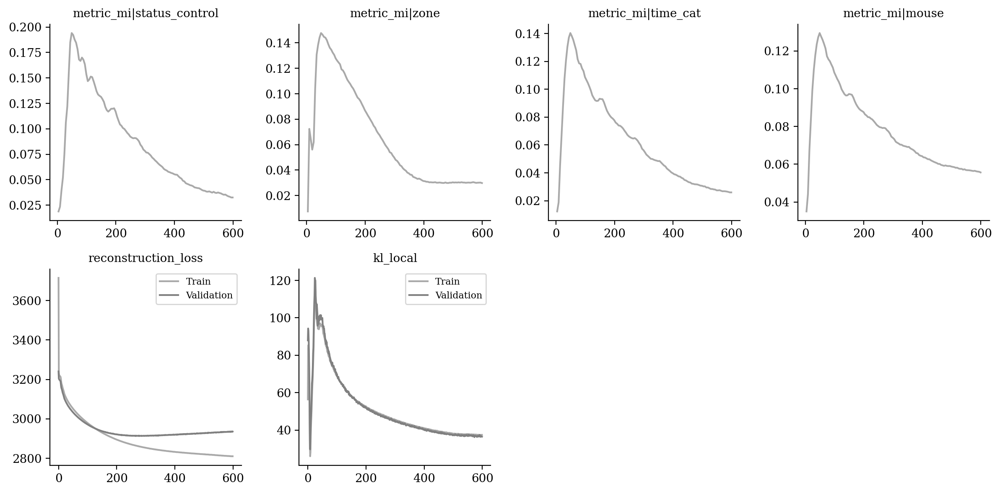

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

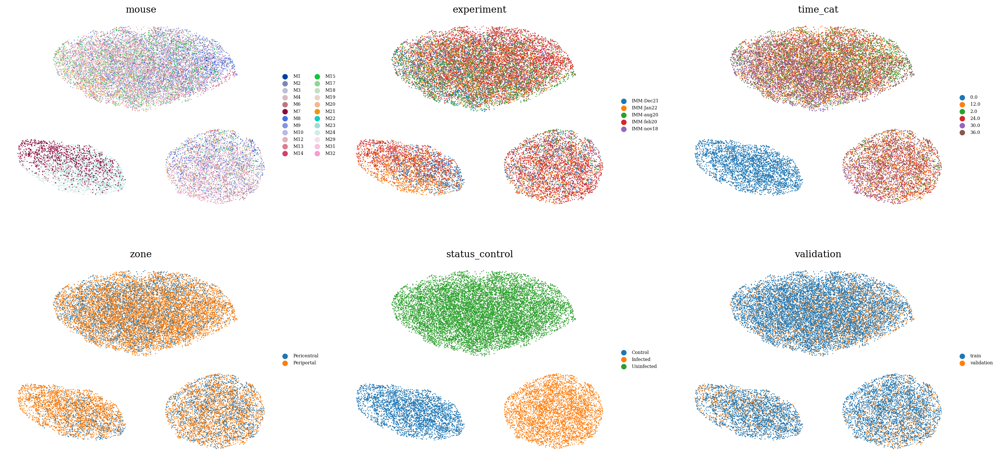

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

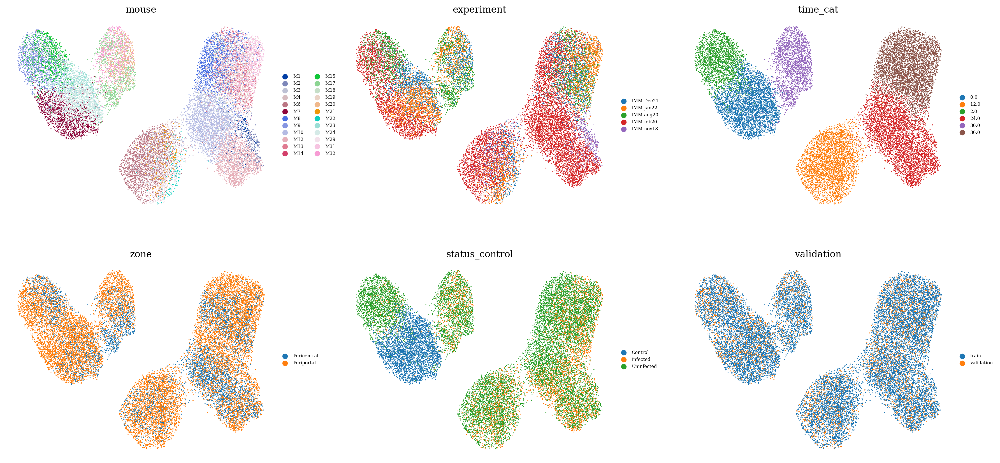

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

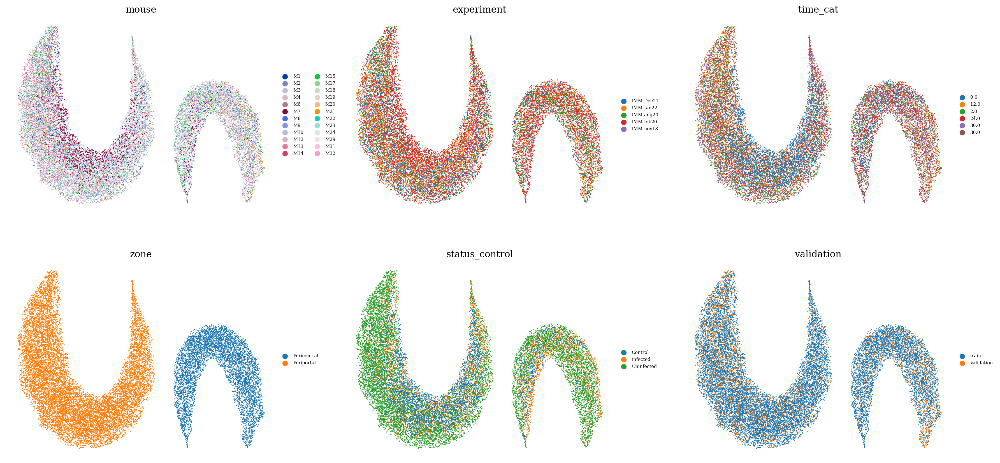

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

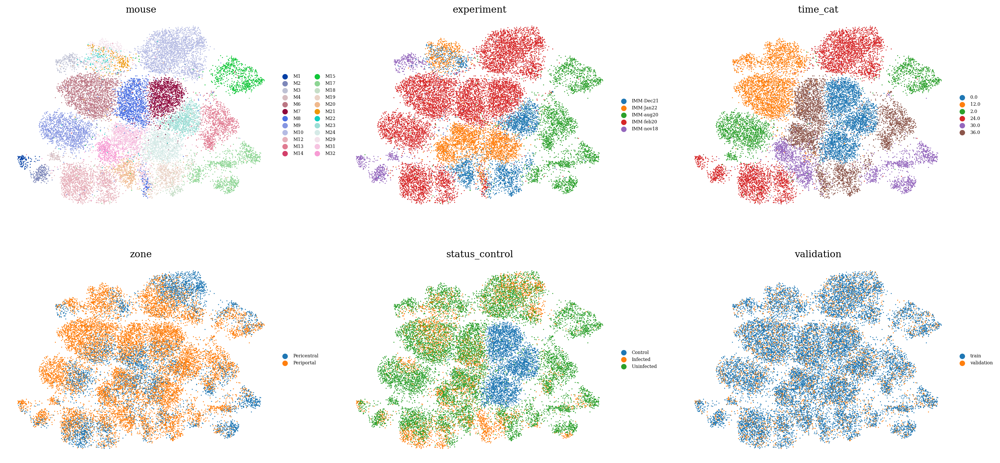

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

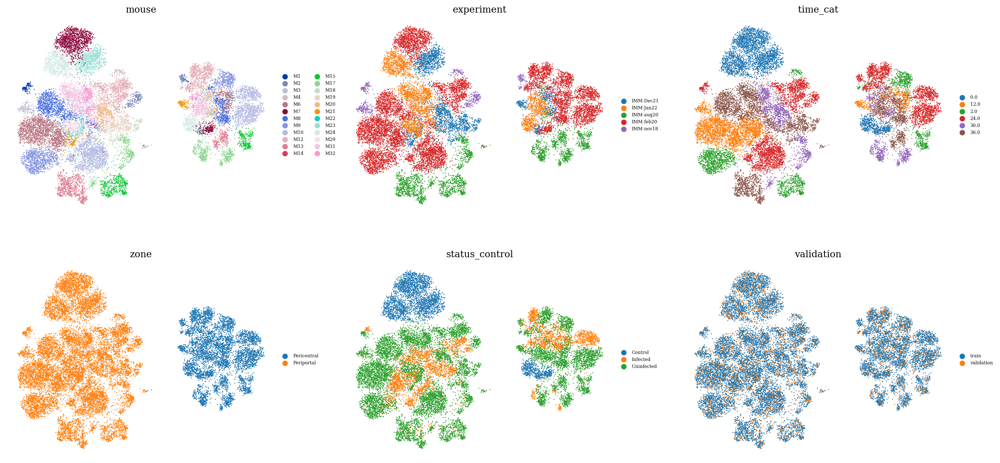

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

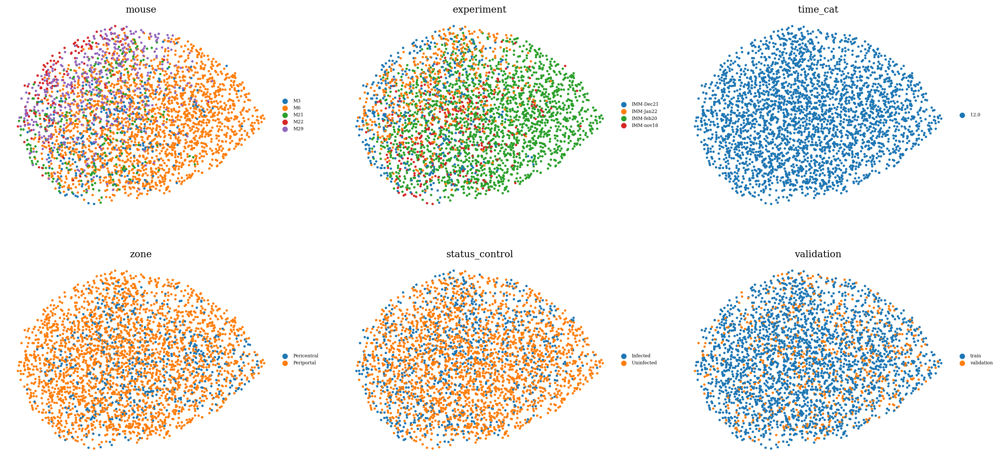

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )